In [136]:
%load_ext autoreload
%autoreload

import pandas as pd
import numpy as np
import os
import sys
import re
import matplotlib.pyplot as plt
import datetime
import seaborn as sns


from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, roc_curve, auc, classification_report
from sklearn.metrics import f1_score, precision_score, recall_score


#Ensemble
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import VotingClassifier
from sklearn.tree import export_graphviz


from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.cluster import KMeans
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import SpectralClustering
from sklearn.cluster import AgglomerativeClustering
from sklearn.decomposition import PCA

from sklearn.metrics import pairwise_distances_argmin_min
from sklearn import metrics

%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')


from itertools import cycle
import networkx as nx
import pydot

from IPython.display import Image

from Bio import SeqIO
from Bio.SeqRecord import SeqRecord
from Bio.Seq import Seq
from Bio.Alphabet import IUPAC

from matplotlib_venn import venn2
from matplotlib_venn import venn3
from lineage import get_lineage_coll, get_lineage_snp
from resistance import get_resistance_snp
from coinfection_functions import import_VCF42_to_pandas, filter_repeats, add_snp_distance, \
                            scatter_vcf_pos, distplot_sns, add_window_distance

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
pd.set_option('display.max_columns', None)

In [4]:
sample_list = []
vcf_files = []
directory = "samples/all_cohort"

for file in os.listdir(directory):
    if file.endswith(".tab"):
        name = file.split(".")[0]
        sample_list.append(name)
        file_path = os.path.join(directory, file)
        vcf_files.append(file_path)
        
sample_list.sort()
vcf_files.sort()

print(sample_list)
print(vcf_files)

['16250874FFD', '17152627', '17160843', '17171479', '1mixed', '2mixed', '3mixed', '4mixed', '56850173', '5mixed', '6mixed', '7mixed', 'AL-75607', 'AL14621', 'BURGOS89109', 'P1_50', 'P1_80', 'P1_90', 'P1_95', 'P2_50', 'P2_80', 'P2_90', 'P2_95', 'P3_50', 'P3_80', 'P3_90', 'P3_95', 'SOMOZACOL2', 'SOMOZACOL3']
['samples/all_cohort/16250874FFD.snp.hf.pass.raw.tab', 'samples/all_cohort/17152627.snp.hf.pass.raw.tab', 'samples/all_cohort/17160843.snp.hf.pass.raw.tab', 'samples/all_cohort/17171479.snp.hf.pass.raw.tab', 'samples/all_cohort/1mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/2mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/3mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/4mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/56850173.snp.hf.pass.raw.tab', 'samples/all_cohort/5mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/6mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/7mixed.snp.hf.pass.raw.tab', 'samples/all_cohort/AL-75607.snp.hf.pass.raw.tab', 'samples/all_cohort/AL14621.snp.hf.pass

# Import vcf as dataframe

In [5]:
dict_vcf = {}
for vcf_file, df_name in zip(vcf_files, sample_list):
    dict_vcf[df_name] = pd.read_csv(vcf_file, sep="\t", header=0)

In [6]:
dict_vcf[sample_list[2]].head()

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10
0,MTB_anc,2532,.,C,T,176817.18,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=1.67;DP=27;Exce...,GT:AD:DP:GQ:PL,"1/1:0,27:27:80:883,80,0",2.0,1.0,2.0,1.670,27.0,0.0061,0.000,0.7937,60.0,0.0,33.22,1.260,0.028,1/1,"0,27",80.0,"883,80,0",NaN,NaN,NaN,2,0.0,27.0,1,1,27.0,0.000000,1.000000,False,2532.0,3608.0,1
1,MTB_anc,6140,.,G,T,26113.26,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.136;DP=73;Ex...,GT:AD:DP:GQ:PL,"0/1:31,42:73:99:1230,0,957",1.0,0.5,2.0,0.136,73.0,0.0000,4.397,0.7016,60.0,0.0,25.96,0.468,0.667,0/1,"31,42",99.0,"1230,0,957",NaN,NaN,NaN,2,31.0,42.0,0,1,73.0,0.424658,0.575342,False,3608.0,3003.0,1
2,MTB_anc,9143,.,C,T,506321.38,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=1.78;DP=65;Exce...,GT:AD:DP:GQ:PL,"1/1:0,65:65:99:2378,195,0",2.0,1.0,2.0,1.780,65.0,3.0103,0.000,-0.0028,60.0,0.0,33.71,0.467,0.764,1/1,"0,65",99.0,"2378,195,0",NaN,NaN,NaN,2,0.0,65.0,1,1,65.0,0.000000,1.000000,False,3003.0,2227.0,1
3,MTB_anc,11370,.,C,T,31089.67,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-3.855e+00;DP=...,GT:AD:DP:GQ:PL,"0/1:49,29:78:99:854,0,1734",1.0,0.5,2.0,-3.855,78.0,0.0000,1.228,0.8146,60.0,0.0,21.89,0.432,0.661,0/1,"49,29",99.0,"854,0,1734",NaN,NaN,NaN,2,49.0,29.0,0,1,78.0,0.628205,0.371795,False,2227.0,2090.0,1
4,MTB_anc,13460,.,G,A,449407.38,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=0.586;DP=83;Exc...,GT:AD:DP:GQ:PL,"1/1:0,83:83:99:2969,249,0",2.0,1.0,2.0,0.586,83.0,3.0103,0.000,-0.0028,60.0,0.0,32.96,1.490,0.237,1/1,"0,83",99.0,"2969,249,0",NaN,NaN,NaN,2,0.0,83.0,1,1,83.0,0.000000,1.000000,False,2090.0,791.0,1


In [7]:
dict_vcf[sample_list[2]].columns

Index(['#CHROM', 'POS', 'ID', 'REF', 'ALT', 'QUAL', 'FILTER', 'INFO', 'FORMAT',
       'sample', 'AC', 'af', 'AN', 'BaseQRankSum', 'DP', 'ExcessHet', 'FS',
       'InbreedingCoeff', 'MQ', 'MQRankSum', 'QD', 'ReadPosRankSum', 'SOR',
       'GT', 'AD', 'GQ', 'PL', 'PGT', 'PID', 'PS', 'len_AD', 'REF_AD',
       'ALT_AD', 'gt0', 'gt1', 'dp', 'aF', 'AF', 'Is_repeat',
       'snp_left_distance', 'snp_right_distance', 'Window_10'],
      dtype='object')

In [11]:
def normalize_InbreedingCoeff(vcf_df):
    max_InbreedingCoeff = vcf_df.InbreedingCoeff.max()
    min_InbreedingCoeff = vcf_df.InbreedingCoeff.min()
     
    
    
    pop_n = 178 #samples used in cohort variant call
    heteroz_num = vcf_df[vcf_df.gt0 != 1].shape[0]
    
    for index, _ in vcf_df.iterrows():
        vcf_df.loc[index, 'InbreedingCoeff_01'] = (vcf_df.loc[index, 'InbreedingCoeff'] - min_InbreedingCoeff) / (max_InbreedingCoeff - min_InbreedingCoeff)
        vcf_df.loc[index, 'InbreedingCoeff_AF'] = vcf_df.loc[index, 'InbreedingCoeff'] / heteroz_num
        vcf_df.loc[index, 'InbreedingCoeff_pop'] = vcf_df.loc[index, 'InbreedingCoeff'] / pop_n
    
    
def normalize_quality(vcf_df):
    max_qual = vcf_df.QUAL.max()
    min_qual = vcf_df.QUAL.min()
    
    max_QD = vcf_df.QD.max()
    min_QD = vcf_df.QD.min()
    
    for index, _ in vcf_df.iterrows():
        vcf_df.loc[index, 'QUAL_01'] = (vcf_df.loc[index, 'QUAL'] - min_qual) / (max_qual - min_qual)
        vcf_df.loc[index, 'QD_01'] = (vcf_df.loc[index, 'QD'] - min_QD) / (max_QD - min_QD)


In [12]:
for name, vcf_df in dict_vcf.items():
    normalize_InbreedingCoeff(vcf_df)
    normalize_quality(vcf_df)

In [13]:
dict_vcf[sample_list[2]].columns

Index(['#CHROM', 'POS', 'ID', 'REF', 'ALT', 'QUAL', 'FILTER', 'INFO', 'FORMAT',
       'sample', 'AC', 'af', 'AN', 'BaseQRankSum', 'DP', 'ExcessHet', 'FS',
       'InbreedingCoeff', 'MQ', 'MQRankSum', 'QD', 'ReadPosRankSum', 'SOR',
       'GT', 'AD', 'GQ', 'PL', 'PGT', 'PID', 'PS', 'len_AD', 'REF_AD',
       'ALT_AD', 'gt0', 'gt1', 'dp', 'aF', 'AF', 'Is_repeat',
       'snp_left_distance', 'snp_right_distance', 'Window_10',
       'InbreedingCoeff_01', 'InbreedingCoeff_AF', 'InbreedingCoeff_pop',
       'QUAL_01', 'QD_01'],
      dtype='object')

In [14]:
dict_vcf[sample_list[2]].head()

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01
0,MTB_anc,2532,.,C,T,176817.18,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=1.67;DP=27;Exce...,GT:AD:DP:GQ:PL,"1/1:0,27:27:80:883,80,0",2.0,1.0,2.0,1.670,27.0,0.0061,0.000,0.7937,60.0,0.0,33.22,1.260,0.028,1/1,"0,27",80.0,"883,80,0",NaN,NaN,NaN,2,0.0,27.0,1,1,27.0,0.000000,1.000000,False,2532.0,3608.0,1,0.442673,0.000760,0.004459,0.254005,0.536530
1,MTB_anc,6140,.,G,T,26113.26,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.136;DP=73;Ex...,GT:AD:DP:GQ:PL,"0/1:31,42:73:99:1230,0,957",1.0,0.5,2.0,0.136,73.0,0.0000,4.397,0.7016,60.0,0.0,25.96,0.468,0.667,0/1,"31,42",99.0,"1230,0,957",NaN,NaN,NaN,2,31.0,42.0,0,1,73.0,0.424658,0.575342,False,3608.0,3003.0,1,0.419516,0.000672,0.003942,0.037472,0.410838
2,MTB_anc,9143,.,C,T,506321.38,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=1.78;DP=65;Exce...,GT:AD:DP:GQ:PL,"1/1:0,65:65:99:2378,195,0",2.0,1.0,2.0,1.780,65.0,3.0103,0.000,-0.0028,60.0,0.0,33.71,0.467,0.764,1/1,"0,65",99.0,"2378,195,0",NaN,NaN,NaN,2,0.0,65.0,1,1,65.0,0.000000,1.000000,False,3003.0,2227.0,1,0.242407,-0.000003,-0.000016,0.727440,0.545014
3,MTB_anc,11370,.,C,T,31089.67,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-3.855e+00;DP=...,GT:AD:DP:GQ:PL,"0/1:49,29:78:99:854,0,1734",1.0,0.5,2.0,-3.855,78.0,0.0000,1.228,0.8146,60.0,0.0,21.89,0.432,0.661,0/1,"49,29",99.0,"854,0,1734",NaN,NaN,NaN,2,49.0,29.0,0,1,78.0,0.628205,0.371795,False,2227.0,2090.0,1,0.447928,0.000780,0.004576,0.044622,0.340374
4,MTB_anc,13460,.,G,A,449407.38,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=0.586;DP=83;Exc...,GT:AD:DP:GQ:PL,"1/1:0,83:83:99:2969,249,0",2.0,1.0,2.0,0.586,83.0,3.0103,0.000,-0.0028,60.0,0.0,32.96,1.490,0.237,1/1,"0,83",99.0,"2969,249,0",NaN,NaN,NaN,2,0.0,83.0,1,1,83.0,0.000000,1.000000,False,2090.0,791.0,1,0.242407,-0.000003,-0.000016,0.645665,0.532029


# Create a set of filtered df in different dictionary

In [15]:
dict_dff = {}
distance = 20
QD = 2
for name, df_vcf in dict_vcf.items():
    list_positions_to_filter = df_vcf['POS'][(
                                (df_vcf.snp_left_distance <= distance)|
                                (df_vcf.snp_right_distance <= distance)|
                                (df_vcf.Window_10 >= 2)|
                                (df_vcf.Is_repeat == True) |
                                (df_vcf.AF <= 0.0) |
                                (df_vcf.len_AD > 2) |
                                (df_vcf.QD <= QD))].tolist()
    dict_dff[name] = df_vcf[~df_vcf.POS.isin(list_positions_to_filter)]

In [16]:
dict_vcf[sample_list[2]][dict_vcf[sample_list[2]].AF < 0.5].QD.describe()

count    569.000000
mean      18.814710
std        6.654136
min        2.230000
25%       14.730000
50%       20.230000
75%       22.950000
max       34.440000
Name: QD, dtype: float64

In [17]:
dict_vcf[sample_list[2]][dict_vcf[sample_list[2]].snp_left_distance <= 30].head()

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01
27,MTB_anc,51954,.,T,A,25977.27,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.86;DP=46;Exc...,GT:AD:DP:GQ:PGT:PID:PL:PS,"0|1:35,11:46:99:1|0:51949_G_A:279,0,1434:51949",1.0,0.5,2.0,1.860,46.0,0.0000,0.561,0.8083,60.00,0.000,22.53,0.786,0.636,0|1,"35,11",99.0,"279,0,1434",1|0,51949_G_A,51949.0,2,35.0,11.0,0,1,46.0,0.760870,0.239130,False,5.0,2440.0,2,0.446344,0.000774,0.004541,0.037276,0.351454
52,MTB_anc,103778,.,G,A,21309.96,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-1.587e+00;DP=...,GT:AD:DP:GQ:PGT:PID:PL:PS,"0|1:32,23:55:99:0|1:103776_G_C:860,0,3647:103776",1.0,0.5,2.0,-1.587,55.0,0.0000,3.249,0.7112,55.30,-0.462,32.68,1.560,0.450,0|1,"32,23",99.0,"860,0,3647",0|1,103776_G_C,103776.0,2,32.0,23.0,0,1,55.0,0.581818,0.418182,True,2.0,1.0,3,0.421930,0.000681,0.003996,0.030570,0.527181
53,MTB_anc,103779,.,G,C,20574.86,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.781;DP=55;Ex...,GT:AD:DP:GQ:PGT:PID:PL:PS,"0|1:32,23:55:99:0|1:103776_G_C:863,0,3625:103776",1.0,0.5,2.0,0.781,55.0,0.0000,3.176,0.6426,55.15,-0.462,30.39,1.620,0.479,0|1,"32,23",99.0,"863,0,3625",0|1,103776_G_C,103776.0,2,32.0,23.0,0,1,55.0,0.581818,0.418182,True,1.0,1045.0,3,0.404682,0.000616,0.003610,0.029514,0.487535
55,MTB_anc,104838,.,G,T,309118.15,PASS,AC=2;AF=1.00;AN=2;BaseQRankSum=-5.940e-01;DP=6...,GT:AD:DP:GQ:PGT:PID:PL:PS,"1|1:0,60:60:99:1|1:104824_A_C:2658,181,0:104824",2.0,1.0,2.0,-0.594,60.0,0.0000,0.000,0.8463,59.50,3.570,31.88,1.740,0.561,1|1,"0,60",99.0,"2658,181,0",1|1,104824_A_C,104824.0,2,0.0,60.0,1,1,60.0,0.000000,1.000000,True,14.0,77.0,1,0.455899,0.000811,0.004754,0.444096,0.513331
57,MTB_anc,104919,.,G,A,23185.49,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=2.49;DP=44;Exc...,GT:AD:DP:GQ:PGT:PID:PL:PS,"0|1:29,15:44:99:0|1:104915_T_C:582,0,1207:104915",1.0,0.5,2.0,2.490,44.0,0.5937,20.519,0.0868,55.08,-0.403,15.95,-1.809,1.243,0|1,"29,15",99.0,"582,0,1207",0|1,104915_T_C,104915.0,2,29.0,15.0,0,1,44.0,0.659091,0.340909,True,4.0,17.0,2,0.264935,0.000083,0.000488,0.033265,0.237535


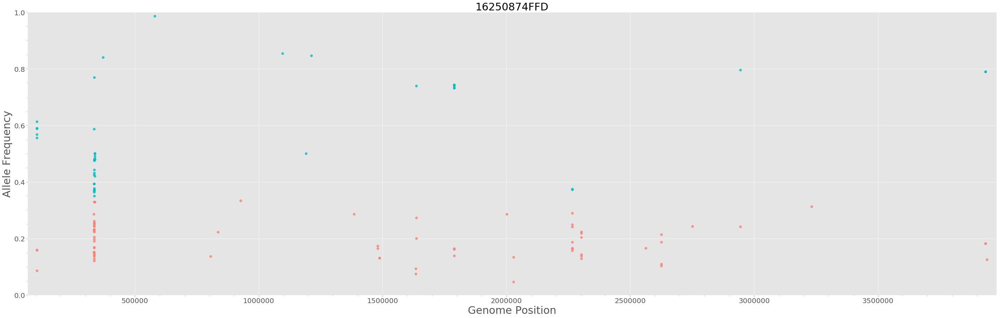

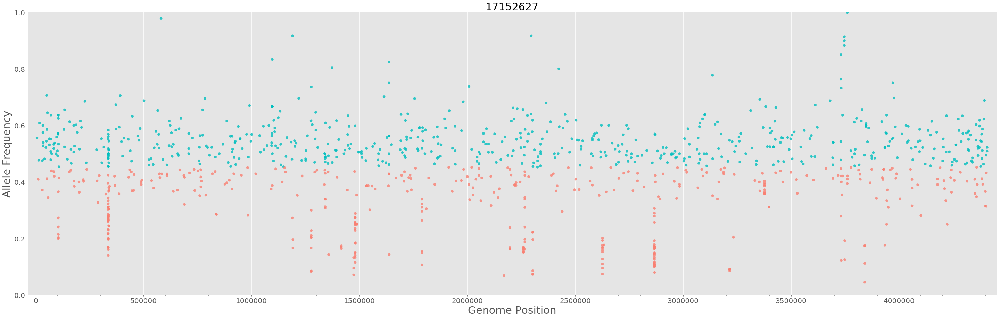

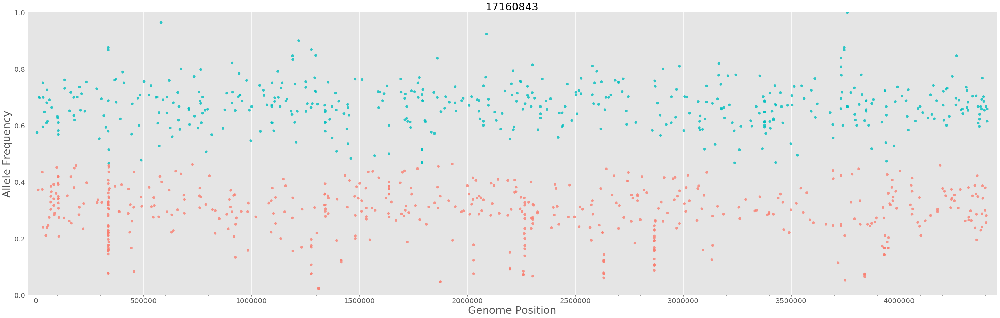

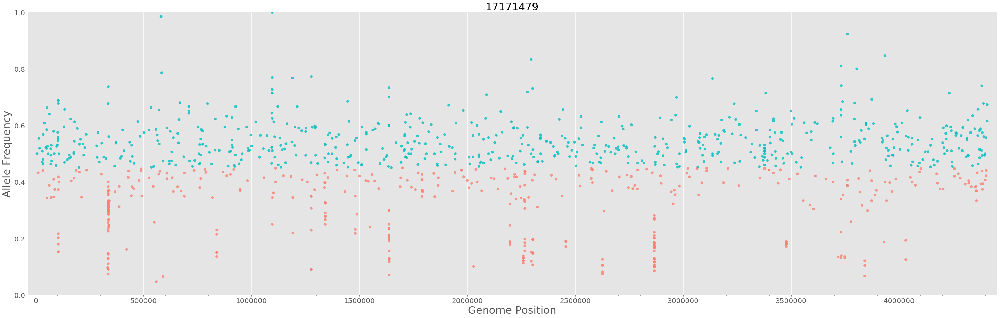

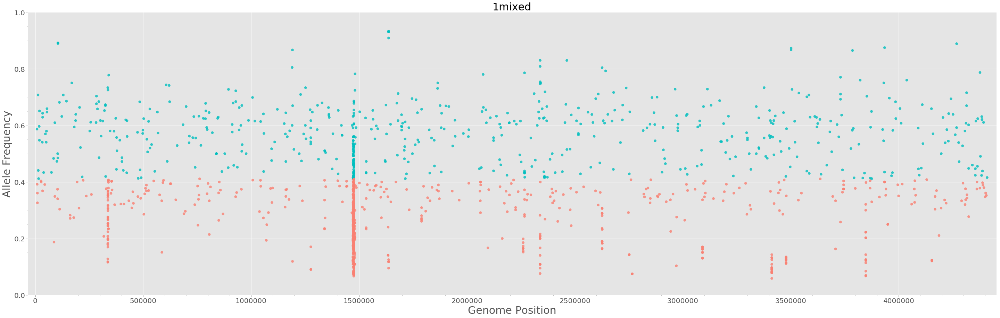

...

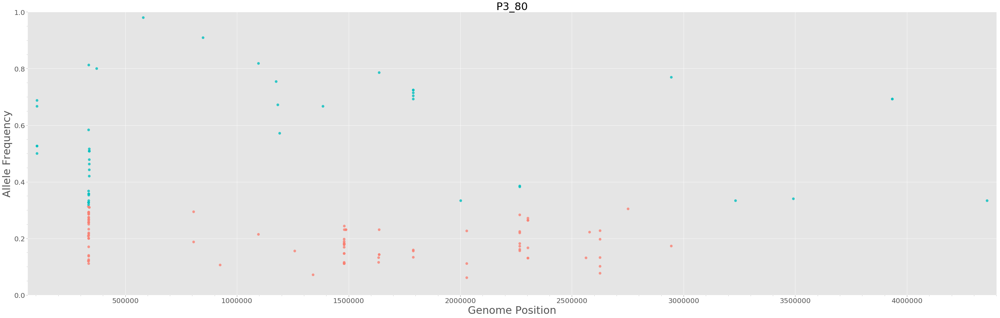

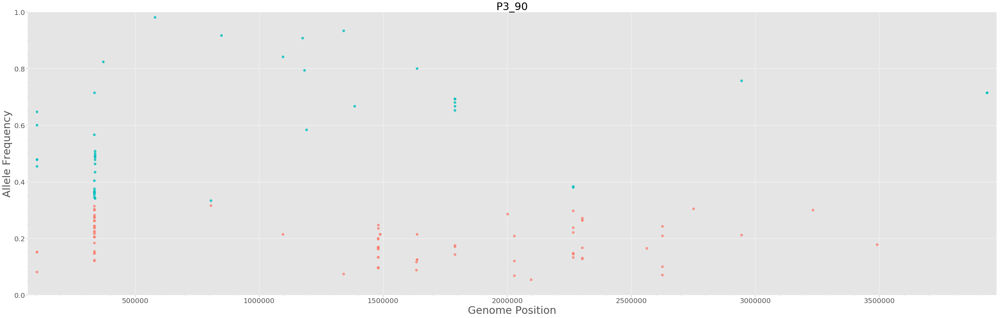

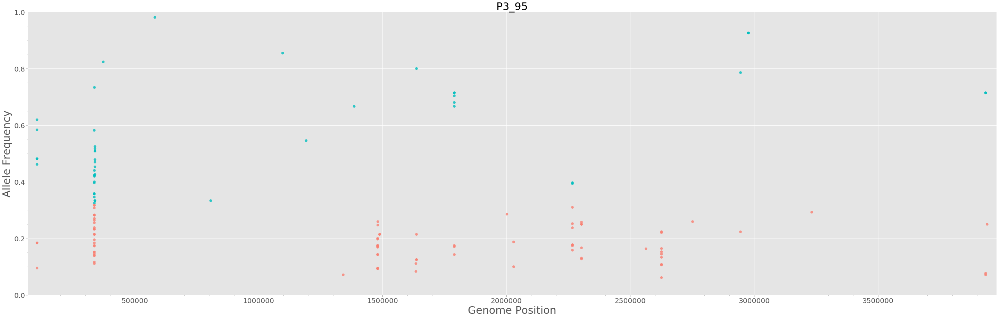

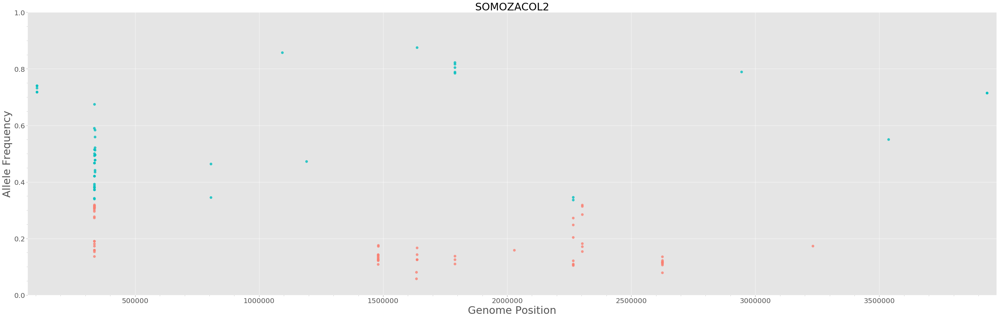

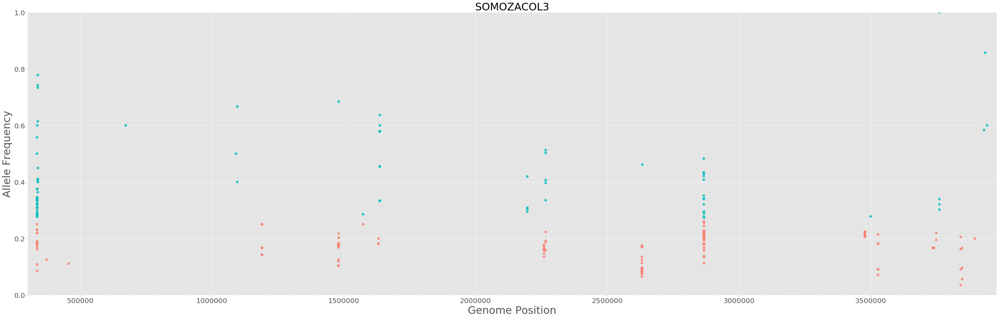

In [18]:
for name_dsf, df in dict_vcf.items():
    scatter_vcf_pos(df,name_dsf)

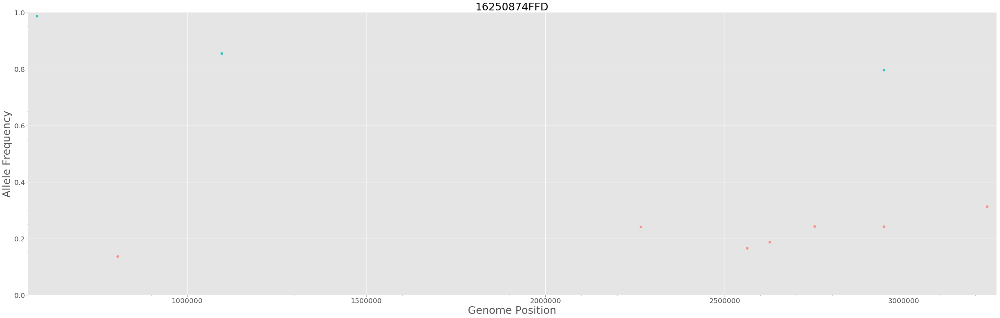

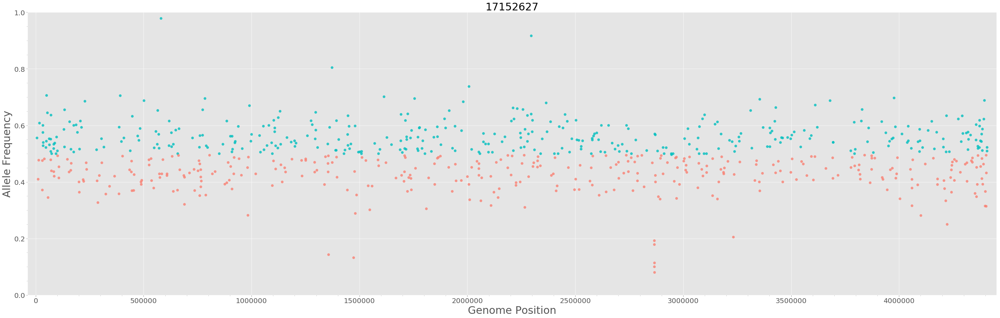

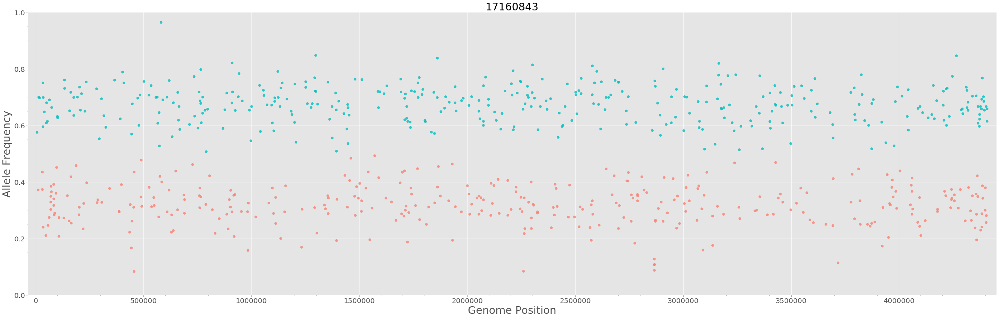

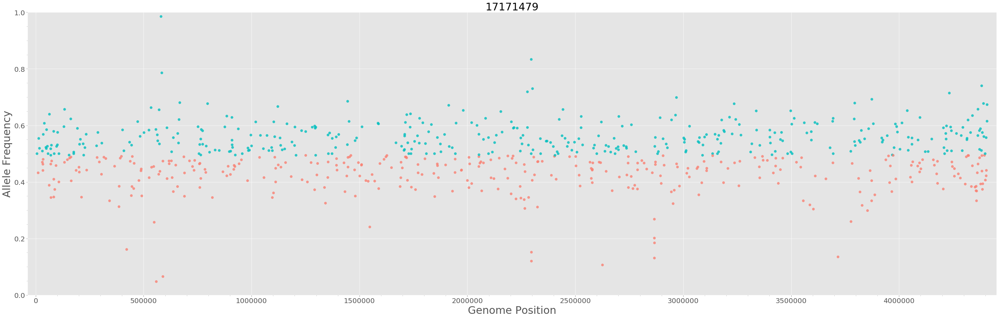

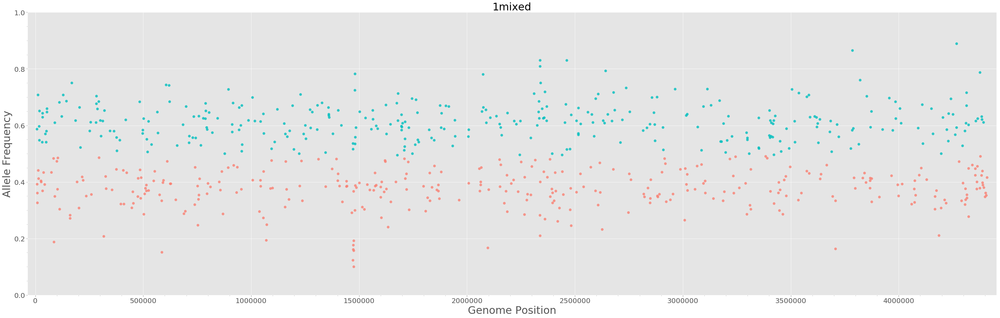

...

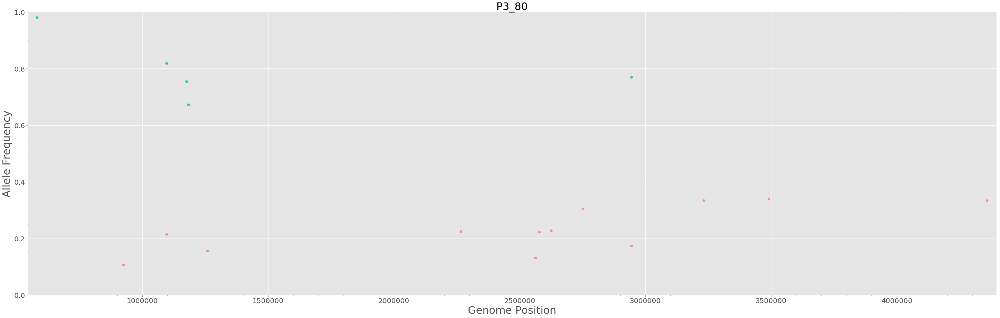

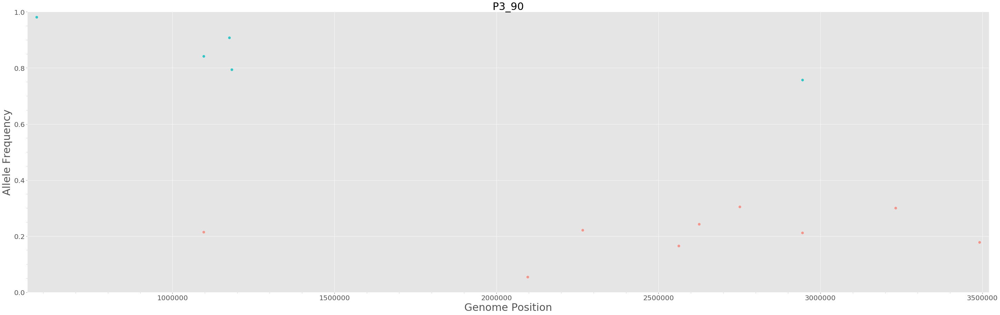

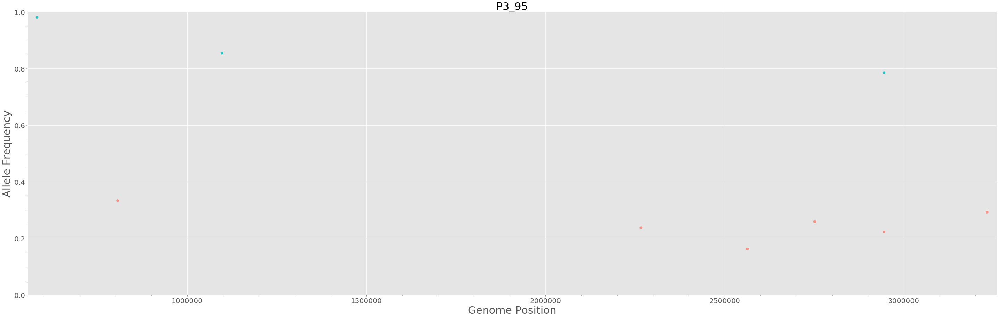

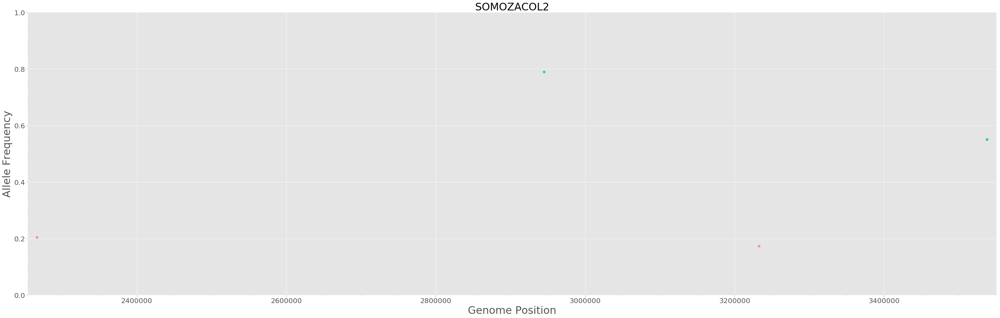

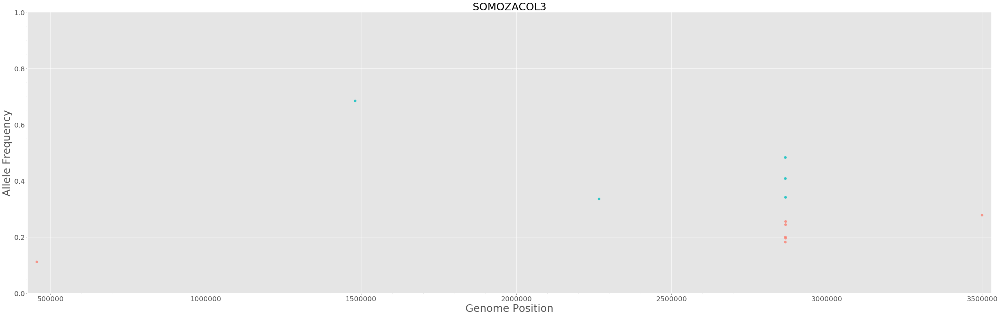

In [19]:
for name_dsf, df in dict_dff.items():
    scatter_vcf_pos(df,name_dsf)

In [20]:
mix1 = dict_dff['5mixed']
mix1[(mix1.AF < 0.2)]

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01
175,MTB_anc,417799,.,A,C,230.39,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.18;DP=87;Exc...,GT:AD:DP:GQ:PL,"0/1:71,16:87:99:253,0,1823",1.0,0.5,2.0,1.180,87.0,3.0103,0.000,-0.0028,60.00,0.000,2.65,0.082,0.783,0/1,"71,16",99.0,"253,0,1823",NaN,NaN,NaN,2,71.0,16.0,0,1,87.0,0.816092,0.183908,False,5519.0,4946.0,1,0.242407,-0.000006,-0.000016,0.000271,0.011207
193,MTB_anc,454616,.,A,C,181.25,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-8.480e-01;DP=...,GT:AD:DP:GQ:PL,"0/1:7,1:8:1:1,0,208",1.0,0.5,2.0,-0.848,8.0,5.7632,11.851,-0.0447,60.00,0.000,2.55,-0.887,0.560,0/1,"7,1",1.0,"1,0,208",NaN,NaN,NaN,2,7.0,1.0,0,1,8.0,0.875000,0.125000,False,283.0,709.0,1,0.231872,-0.000095,-0.000251,0.000200,0.009483
196,MTB_anc,456237,.,T,A,1576.78,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.824;DP=28;Ex...,GT:AD:DP:GQ:PGT:PID:PL:PS,"0|1:27,1:28:42:0|1:456237_T_A:42,0,1294:456237",1.0,0.5,2.0,0.824,28.0,4.6169,5.053,-0.0420,59.99,0.000,2.79,-1.375,0.745,0|1,"27,1",42.0,"42,0,1294",0|1,456237_T_A,456237.0,2,27.0,1.0,0,1,28.0,0.964286,0.035714,False,908.0,179.0,1,0.232551,-0.000089,-0.000236,0.002205,0.013621
398,MTB_anc,1210173,.,C,G,108.39,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-2.661e+00;DP=...,GT:AD:DP:GQ:PGT:PID:PL:PS,"0|1:50,3:53:99:0|1:1210169_C_G:131,0,4988:1210169",1.0,0.5,2.0,-2.661,53.0,3.0103,30.687,-0.0028,60.00,0.000,2.05,-2.852,2.773,0|1,"50,3",99.0,"131,0,4988",0|1,1210169_C_G,1210169.0,2,50.0,3.0,0,1,53.0,0.943396,0.056604,False,1992.0,2851.0,1,0.242407,-0.000006,-0.000016,0.000095,0.000862
468,MTB_anc,1472150,.,T,A,13822.03,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.330;DP=66;Ex...,GT:AD:DP:GQ:PL,"0/1:60,6:66:79:79,0,2474",1.0,0.5,2.0,0.330,66.0,3.3593,1.735,-0.0230,59.71,-1.673,17.36,-0.679,0.584,0/1,"60,6",79.0,"79,0,2474",NaN,NaN,NaN,2,60.0,6.0,0,1,66.0,0.909091,0.090909,False,3942.0,22.0,1,0.237328,-0.000049,-0.000129,0.019799,0.264828
486,MTB_anc,1472382,.,G,A,1084.67,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-8.430e-01;DP=...,GT:AD:DP:GQ:PL,"0/1:60,8:68:99:208,0,2511",1.0,0.5,2.0,-0.843,68.0,3.4526,0.000,-0.0237,59.65,-2.733,2.80,0.209,0.821,0/1,"60,8",99.0,"208,0,2511",NaN,NaN,NaN,2,60.0,8.0,0,1,68.0,0.882353,0.117647,False,38.0,135.0,1,0.237152,-0.000050,-0.000133,0.001498,0.013793
491,MTB_anc,1472616,.,G,A,527.28,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-6.570e-01;DP=...,GT:AD:DP:GQ:PL,"0/1:68,8:76:31:31,0,1884",1.0,0.5,2.0,-0.657,76.0,3.3495,2.342,-0.0157,59.91,0.000,2.87,-0.922,0.961,0/1,"68,8",31.0,"31,0,1884",NaN,NaN,NaN,2,68.0,8.0,0,1,76.0,0.894737,0.105263,False,75.0,39.0,1,0.239163,-0.000033,-0.000088,0.000697,0.015000
492,MTB_anc,1472655,.,G,A,15477.79,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-1.435e+00;DP=...,GT:AD:DP:GQ:PL,"0/1:58,9:67:99:188,0,2421",1.0,0.5,2.0,-1.435,67.0,0.2892,1.102,0.1589,59.84,-1.009,14.98,-0.488,0.792,0/1,"58,9",99.0,"188,0,2421",NaN,NaN,NaN,2,58.0,9.0,0,1,67.0,0.865672,0.134328,False,39.0,42.0,1,0.283063,0.000338,0.000893,0.022179,0.223793
495,MTB_anc,1472742,.,C,T,11273.41,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-1.229e+00;DP=...,GT:AD:DP:GQ:PL,"0/1:68,16:84:99:266,0,1842",1.0,0.5,2.0,-1.229,84.0,3.4577,4.274,-0.0245,59.87,-1.419,13.42,-0.746,1.010,0/1,"68,16",99.0,"266,0,1842",NaN,NaN,NaN,2,68.0,16.0,0,1,84.0,0.809524,0.190476,False,35.0,39.0,1,0.236951,-0.000052,-0.000138,0.016138,0.196897
504,MTB_anc,1472982,.,G,A,4227.13,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=2.36;DP=103;Ex...,GT:AD:DP:GQ:PL,"0/1:82,17:103:99:464,0,3434",1.0,0.5,2.0,2.360,103.0,3.4603,3.449,-0.0252,59.95,0.000,6.00,-1.227,0.871,0/1,"82,17",99.0,"464,0,3434",NaN,NaN,NaN,2,82.0,17.0,0,1,99.0,0.828283,0.171717,False,65.0,23.0,1,0.236775,-0.000054,-0.000142,0.006013,0.068966


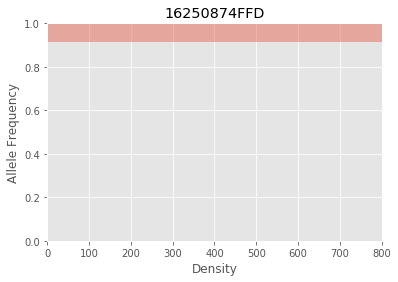

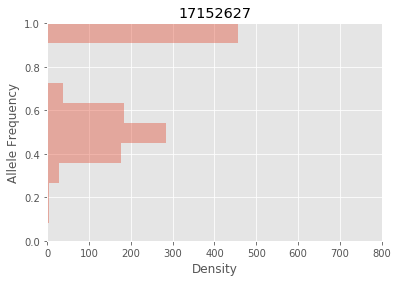

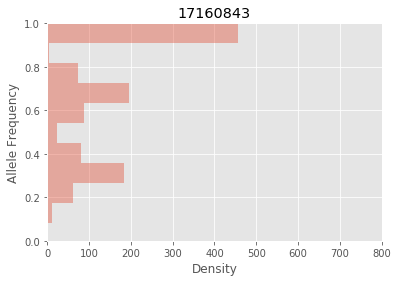

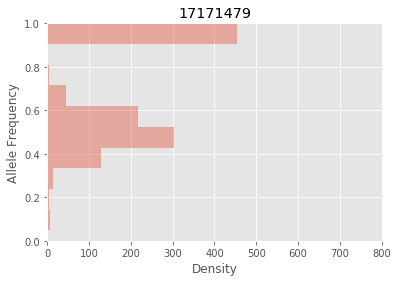

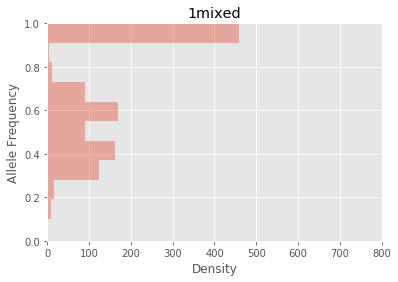

...

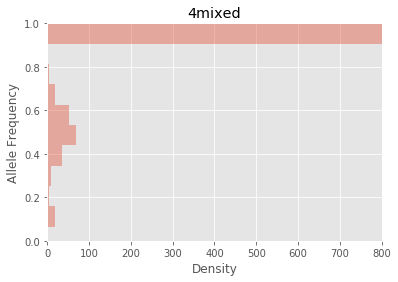

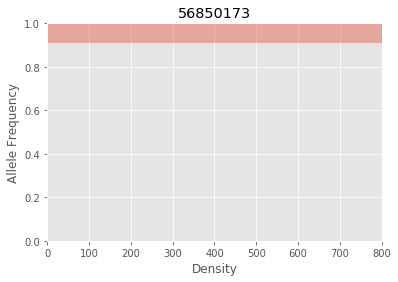

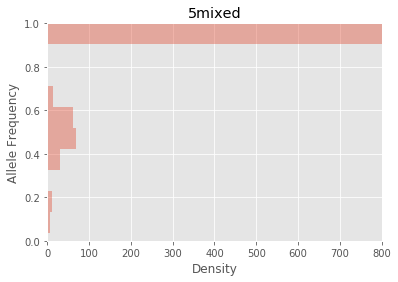

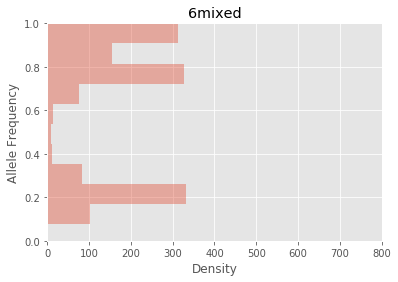

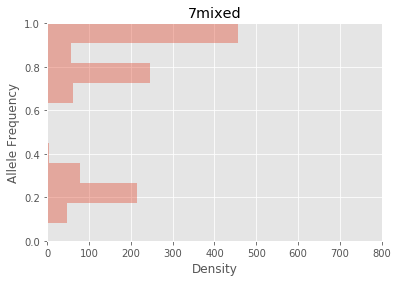

/home/laura/env36/lib/python3.6/site-packages/numpy/lib/histograms.py:824: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/laura/env36/lib/python3.6/site-packages/numpy/lib/histograms.py:825: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


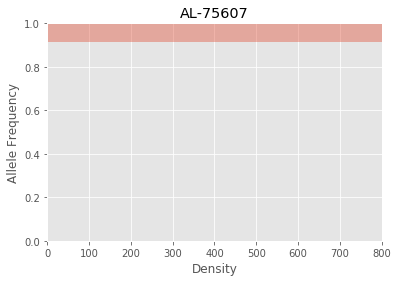

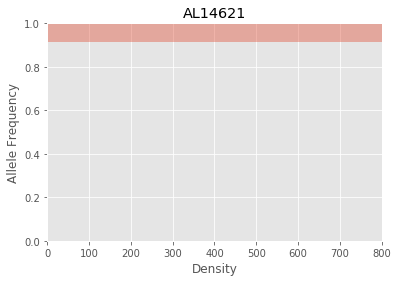

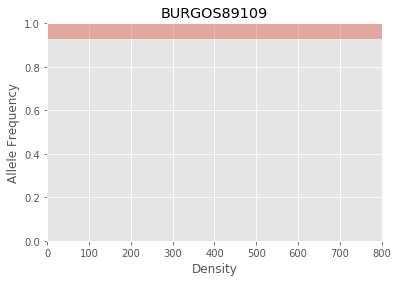

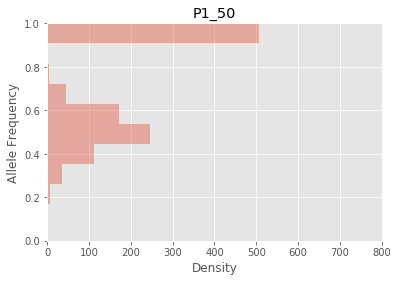

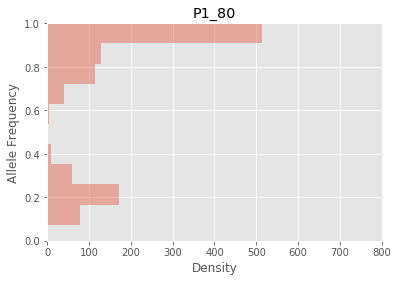

...

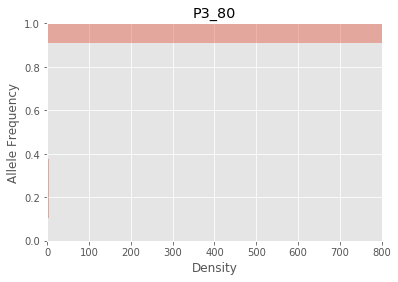

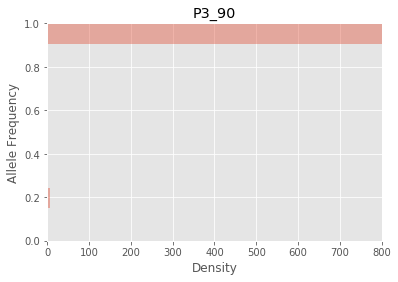

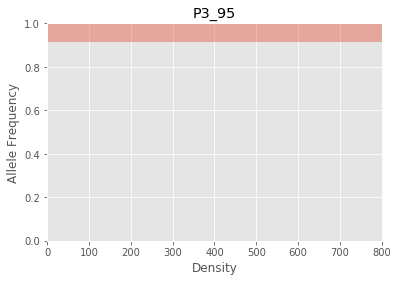

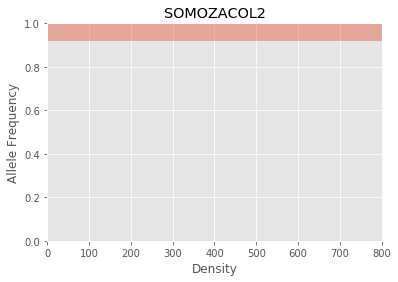

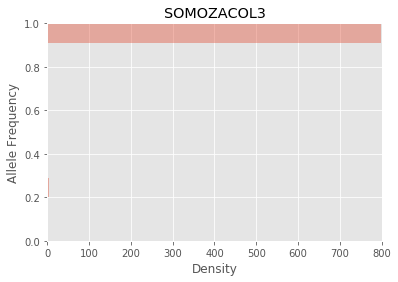

In [21]:
for name_dsf, df in dict_dff.items():
    distplot_sns(df,name_dsf)

In [22]:
def split_df_mean(vcf_df):
    #filter_homoz_top = homoz
    #filter_homoz_bottom = (1 - filter_homoz_top)
    
    #mean = vcf_df['AF'][(vcf_df['AF'] <= filter_homoz_top) & (vcf_df['AF'] >= filter_homoz_bottom)].mean(axis = 0)
    mean = vcf_df['AF'][(vcf_df.AC != 2) & (vcf_df.gt0 != 1)].mean(axis = 0)    


    top_positions = vcf_df['POS'][(vcf_df['AF'] >= mean) & (vcf_df.AC != 2) & (vcf_df.gt0 != 1)].tolist()
    bottom_positions = vcf_df['POS'][(vcf_df['AF'] < mean)].tolist()
    
    return top_positions, bottom_positions

In [23]:
dict_t_b = {}
for name_dff, df_dff in dict_dff.items():
    name_top = name_dff + "_t"
    name_btm = name_dff + "_b"
    name_top , name_btm = split_df_mean(df_dff)
    dict_t_b[name_dff] = name_top , name_btm

In [24]:
for k,v in dict_t_b.items():
    print(k,len(v[0]), len(v[1]))

16250874FFD 3 7
17152627 368 354
17160843 376 348
17171479 373 352
1mixed 337 341
2mixed 378 489
3mixed 878 757
4mixed 121 92
56850173 3 5
5mixed 123 79
6mixed 576 537
7mixed 366 346
AL-75607 4 5
AL14621 5 3
BURGOS89109 2 3
P1_50 309 316
P1_80 292 321
P1_90 187 191
P1_95 57 46
P2_50 26 16
P2_80 17 23
P2_90 12 19
P2_95 7 9
P3_50 4 11
P3_80 5 12
P3_90 5 9
P3_95 3 6
SOMOZACOL2 2 2
SOMOZACOL3 5 7


# Start K-means clustering

### Thanks to: http://www.aprendemachinelearning.com/k-means-en-python-paso-a-paso/

In [25]:
dict_dff['1mixed'].describe()

,POS,QUAL,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GQ,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01
count,1.136000e+03,1136.000000,1136.000000,1136.000000,1136.0,1135.000000,1136.000000,1136.000000,1136.000000,1136.000000,1136.000000,1135.000000,1136.000000,1135.000000,1136.000000,1136.000000,1.200000e+01,1136.0,1136.000000,1136.000000,1136.000000,1136.0,1136.000000,1136.000000,1136.000000,1136.000000,1136.000000,1136.0,1136.000000,1136.000000,1136.000000,1136.000000,1136.000000
mean,2.175387e+06,164276.220053,1.403169,0.701585,2.0,0.040606,96.250000,2.759834,1.661766,0.195488,59.828636,-0.002659,20.940607,0.165938,0.730327,98.114437,2.060235e+06,2.0,29.293134,66.882042,0.403169,1.0,96.175176,0.303090,0.696910,3451.848592,3418.331866,1.0,0.292263,0.000147,0.001098,0.235985,0.349850
std,1.311961e+06,192176.685956,0.490750,0.245375,0.0,2.529361,30.077331,6.216449,3.089417,0.385131,1.443165,0.430856,10.751288,0.971081,0.258392,7.369130,1.286800e+06,0.0,29.311924,33.809211,0.490750,0.0,30.084172,0.270536,0.270536,3698.308581,3626.603849,0.0,0.096835,0.000290,0.002164,0.276122,0.179647
min,2.532000e+03,33.790000,1.000000,0.500000,2.0,-6.596000,6.000000,-0.000000,0.000000,-0.956200,40.080000,-7.300000,2.390000,-3.272000,0.028000,4.000000,8.483000e+04,2.0,0.000000,2.000000,0.000000,1.0,6.000000,0.000000,0.100000,21.000000,21.000000,1.0,0.002690,-0.000720,-0.005372,0.000000,0.039882
25%,1.056896e+06,994.140000,1.000000,0.500000,2.0,-2.025500,77.000000,3.010300,0.000000,-0.002900,60.000000,0.000000,10.525000,-0.421500,0.578750,99.000000,9.479315e+05,2.0,0.000000,41.000000,0.000000,1.0,77.000000,0.000000,0.438027,941.500000,941.500000,1.0,0.242382,-0.000002,-0.000016,0.001380,0.175812
50%,2.151302e+06,2274.395000,1.000000,0.500000,2.0,0.925000,95.000000,3.010300,0.000000,-0.002800,60.000000,0.000000,19.310000,0.204000,0.700000,99.000000,2.303103e+06,2.0,29.000000,61.000000,0.000000,1.0,95.000000,0.361278,0.638722,2293.000000,2234.500000,1.0,0.242407,-0.000002,-0.000016,0.003219,0.322604
75%,3.303923e+06,330094.880000,2.000000,1.000000,2.0,1.770000,115.000000,3.010300,2.169500,-0.002800,60.000000,0.000000,32.250000,0.852000,0.836000,99.000000,3.151767e+06,2.0,50.000000,89.250000,1.000000,1.0,115.000000,0.561973,1.000000,4756.250000,4711.000000,1.0,0.242407,-0.000002,-0.000016,0.474236,0.538822
max,4.409602e+06,685307.340000,2.000000,1.000000,2.0,6.710000,214.000000,160.000000,29.011000,1.000000,60.000000,7.000000,36.880000,4.340000,2.990000,99.000000,3.707593e+06,2.0,151.000000,196.000000,1.000000,1.0,214.000000,0.900000,1.000000,25495.000000,25495.000000,1.0,0.494544,0.000753,0.005618,0.984609,0.616187


In [26]:
S2 = set(dict_dff['SOMOZACOL2'].POS.values)
S3 = set(dict_dff['SOMOZACOL3'].POS.values)

S3_exclusive = S3 - S2
S2_exclusive = S2 - S3
Shared_2_3 = S2 & S3
total_difference_2_3 = (len(S2_exclusive) + len(S3_exclusive))
print("S2 has %s unique positions\n\
S3 has %s unique positions\n\
Both share %s positions\n\
Total difference: %s" % (len(S2_exclusive) , len(S3_exclusive), len(Shared_2_3),total_difference_2_3 ))

S2 has 385 unique positions
S3 has 359 unique positions
Both share 450 positions
Total difference: 744


In [27]:
B = set(dict_dff['BURGOS89109'].POS.values)
P = set(dict_dff['56850173'].POS.values)
A75 = set(dict_dff['AL-75607'].POS.values)
A14 = set(dict_dff['AL14621'].POS.values)
F = set(dict_dff['16250874FFD'].POS.values)
S = set(dict_dff['SOMOZACOL2'].POS.values)

B_exclusive = B - P
P_exclusive = P - B
Shared_B_P = P & B
total_difference_B_P = (len(B_exclusive) + len(P_exclusive))
print("B has %s unique positions\n\
P has %s unique positions\n\
Both share %s positions\n\
Total difference: %s" % (len(B_exclusive) , len(P_exclusive), len(Shared_B_P),total_difference_B_P ))

B has 306 unique positions
P has 334 unique positions
Both share 504 positions
Total difference: 640


In [28]:
A75_exclusive = A75 - A14
A14_exclusive = A14 - A75
Shared_A75_A14 = A14 & A75

print("A75 has %s unique positions\n\
A14 has %s unique positions\n\
Both share %s positions" % (len(A75_exclusive) , len(A14_exclusive), len(Shared_A75_A14)))

A75 has 19 unique positions
A14 has 19 unique positions
Both share 856 positions


In [29]:
def assign_group_1(row):
    if row.POS in dict_t_b['1mixed'][0]:
        return 1
    elif row.POS in dict_t_b['1mixed'][1]:
        return 2
    else:
        return 3
    
def assign_group_2(row):
    if row.POS in dict_t_b['2mixed'][0]:
        return 1
    elif row.POS in dict_t_b['2mixed'][1]:
        return 2
    else:
        return 3
    
def assign_group_3(row):
    if row.POS in dict_t_b['3mixed'][0]:
        return 1
    elif row.POS in dict_t_b['3mixed'][1]:
        return 2
    else:
        return 3
    
def assign_group_6(row):
    if row.POS in dict_t_b['6mixed'][0]:
        return 1
    elif row.POS in dict_t_b['6mixed'][1]:
        return 2
    else:
        return 3

def assign_group_7(row):
    if row.POS in dict_t_b['7mixed'][0]:
        return 1
    elif row.POS in dict_t_b['7mixed'][1]:
        return 2
    else:
        return 3
    
def assign_group_somoza(row):
    if row.POS in S2_exclusive:
        return 1
    elif row.POS in S3_exclusive:
        return 2
    else:
        return 3
    
def assign_group_P1(row):
    if row.POS in B_exclusive:
        return 1
    elif row.POS in P_exclusive:
        return 2
    else:
        return 3
    
def assign_group_P2(row):
    if row.POS in A75_exclusive:
        return 1
    elif row.POS in A14_exclusive:
        return 2
    else:
        return 3

In [30]:
Ktest1 = dict_dff['1mixed'][(dict_dff['1mixed'].AC != 2)]
Ktest2 = dict_dff['2mixed'][(dict_dff['2mixed'].AC != 2)]
Ktest3 = dict_dff['3mixed'][(dict_dff['3mixed'].AC != 2)]
Ktest6 = dict_dff['6mixed'][(dict_dff['6mixed'].AC != 2)]
Ktest7 = dict_dff['7mixed'][(dict_dff['7mixed'].AC != 2)]

Ktest15 = dict_dff['17152627'][(dict_dff['17152627'].AC != 2) & (dict_dff['17152627'].gt0 != 1)]
Ktest16 = dict_dff['17160843'][(dict_dff['17160843'].AC != 2) & (dict_dff['17160843'].gt0 != 1)]
Ktest17 = dict_dff['17171479'][(dict_dff['17171479'].AC != 2) & (dict_dff['17171479'].gt0 != 1)]

Atest5 = dict_dff['P2_50'][(dict_dff['P2_50'].AC != 2) & (dict_dff['P2_50'].gt0 != 1)]
Atest8 = dict_dff['P2_80'][(dict_dff['P2_80'].AC != 2) & (dict_dff['P2_80'].gt0 != 1)]
Atest9 = dict_dff['P2_90'][(dict_dff['P2_90'].AC != 2) & (dict_dff['P2_90'].gt0 != 1)]


Ptest5 = dict_dff['P1_50'][(dict_dff['P1_50'].AC != 2) & (dict_dff['P1_50'].gt0 != 1)]
Ptest8 = dict_dff['P1_80'][(dict_dff['P1_80'].AC != 2) & (dict_dff['P1_80'].gt0 != 1)]
Ptest9 = dict_dff['P1_90'][(dict_dff['P1_90'].AC != 2) & (dict_dff['P1_90'].gt0 != 1)]
Ptest95 = dict_dff['P1_95'][(dict_dff['P1_95'].AC != 2) & (dict_dff['P1_95'].gt0 != 1)]

In [31]:
Ktest1['category'] = Ktest1.apply(assign_group_1, axis=1)
Ktest2['category'] = Ktest2.apply(assign_group_2, axis=1)
Ktest3['category'] = Ktest3.apply(assign_group_3, axis=1)
Ktest6['category'] = Ktest6.apply(assign_group_6, axis=1)
Ktest7['category'] = Ktest7.apply(assign_group_7, axis=1)

Ktest15['category'] = Ktest15.apply(assign_group_somoza, axis=1)
Ktest16['category'] = Ktest16.apply(assign_group_somoza, axis=1)
Ktest17['category'] = Ktest17.apply(assign_group_somoza, axis=1)

Atest5['category'] = Atest5.apply(assign_group_P2, axis=1)
Atest8['category'] = Atest8.apply(assign_group_P2, axis=1)
Atest9['category'] = Atest9.apply(assign_group_P2, axis=1)



Ptest5['category'] = Ptest5.apply(assign_group_P1, axis=1)
Ptest8['category'] = Ptest8.apply(assign_group_P1, axis=1)
Ptest9['category'] = Ptest9.apply(assign_group_P1, axis=1)
Ptest95['category'] = Ptest95.apply(assign_group_P1, axis=1)

/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http:

In [32]:
Ktest15 = Ktest15[Ktest15.category != 3]
Ktest16 = Ktest16[Ktest16.category != 3]
Ktest17 = Ktest17[Ktest17.category != 3]

Atest5 = Atest5[Atest5.category != 3]
Atest8 = Atest8[Atest8.category != 3]
Atest9 = Atest9[Atest9.category != 3]


Ptest5 = Ptest5[Ptest5.category != 3]
Ptest8 = Ptest8[Ptest8.category != 3]
Ptest9 = Ptest9[Ptest9.category != 3]
Ptest95 = Ptest95[Ptest95.category != 3]

/home/laura/env36/lib/python3.6/site-packages/numpy/lib/histograms.py:778: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
  a, weights = _ravel_and_check_weights(a, weights)


<Figure size 36000x36000 with 0 Axes>

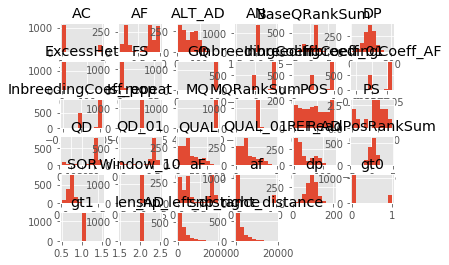

In [33]:
plt.figure(figsize=(500,500))

dict_dff['6mixed'].hist()

plt.show()

In [34]:
Ktest6.head()

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01,category
0,MTB_anc,698,.,G,A,333.39,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-2.150e-01;DP=...,GT:AD:DP:GQ:PL,"0/1:69,17:86:99:356,0,2085",1.0,0.5,2.0,-0.215,86.0,3.0103,2.236,-0.0028,60.0,0.0,3.88,1.380,1.025,0/1,"69,17",99.0,"356,0,2085",NaN,NaN,NaN,2,69.0,17.0,0,1,86.0,0.802326,0.197674,False,698.0,1151.0,1,0.490162,-0.000002,-0.000016,0.000430,0.032247,2
1,MTB_anc,1849,.,C,A,142248.68,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.77;DP=88;Exc...,GT:AD:DP:GQ:PL,"0/1:22,66:88:99:1714,0,401",1.0,0.5,2.0,1.770,88.0,0.0000,0.000,0.9873,60.0,0.0,31.92,0.775,0.375,0/1,"22,66",99.0,"1714,0,401",NaN,NaN,NaN,2,22.0,66.0,0,1,88.0,0.250000,0.750000,False,1151.0,683.0,1,0.993543,0.000665,0.005547,0.204336,0.515779,1
5,MTB_anc,8040,.,G,A,80579.86,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=-1.728e+00;DP=...,GT:AD:DP:GQ:PL,"0/1:72,18:90:99:281,0,1957",1.0,0.5,2.0,-1.728,90.0,0.0000,0.000,0.9518,60.0,0.0,31.42,-0.469,0.583,0/1,"72,18",99.0,"281,0,1957",NaN,NaN,NaN,2,72.0,18.0,0,1,90.0,0.800000,0.200000,False,458.0,1103.0,1,0.975494,0.000641,0.005347,0.115729,0.507156,2
7,MTB_anc,11820,.,C,G,158057.19,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.76;DP=98;Exc...,GT:AD:DP:GQ:PL,"0/1:17,81:98:99:2330,0,311",1.0,0.5,2.0,1.760,98.0,0.0000,0.000,0.9872,60.0,0.0,30.62,1.490,0.391,0/1,"17,81",99.0,"2330,0,311",NaN,NaN,NaN,2,17.0,81.0,0,1,98.0,0.173469,0.826531,False,2677.0,1640.0,1,0.993492,0.000665,0.005546,0.227050,0.493361,1
9,MTB_anc,13638,.,T,C,1469.54,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=3.38;DP=111;Ex...,GT:AD:DP:GQ:PL,"0/1:58,53:111:99:1492,0,1412",1.0,0.5,2.0,3.380,111.0,3.0830,0.000,-0.0071,60.0,0.0,13.24,1.450,0.700,0/1,"58,53",99.0,"1492,0,1412",NaN,NaN,NaN,2,58.0,53.0,0,1,111.0,0.522523,0.477477,False,178.0,613.0,1,0.487976,-0.000005,-0.000040,0.002063,0.193654,2


In [35]:
Ktest1[Ktest1.category == 3]

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01,category


In [36]:
Ktest6[Ktest6.category == 3]

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01,category


In [37]:
Ktest6.columns

Index(['#CHROM', 'POS', 'ID', 'REF', 'ALT', 'QUAL', 'FILTER', 'INFO', 'FORMAT',
       'sample', 'AC', 'af', 'AN', 'BaseQRankSum', 'DP', 'ExcessHet', 'FS',
       'InbreedingCoeff', 'MQ', 'MQRankSum', 'QD', 'ReadPosRankSum', 'SOR',
       'GT', 'AD', 'GQ', 'PL', 'PGT', 'PID', 'PS', 'len_AD', 'REF_AD',
       'ALT_AD', 'gt0', 'gt1', 'dp', 'aF', 'AF', 'Is_repeat',
       'snp_left_distance', 'snp_right_distance', 'Window_10',
       'InbreedingCoeff_01', 'InbreedingCoeff_AF', 'InbreedingCoeff_pop',
       'QUAL_01', 'QD_01', 'category'],
      dtype='object')

/home/laura/env36/lib/python3.6/site-packages/seaborn/axisgrid.py:2065: UserWarning: The `size` parameter has been renamed to `height`; pleaes update your code.
  warnings.warn(msg, UserWarning)


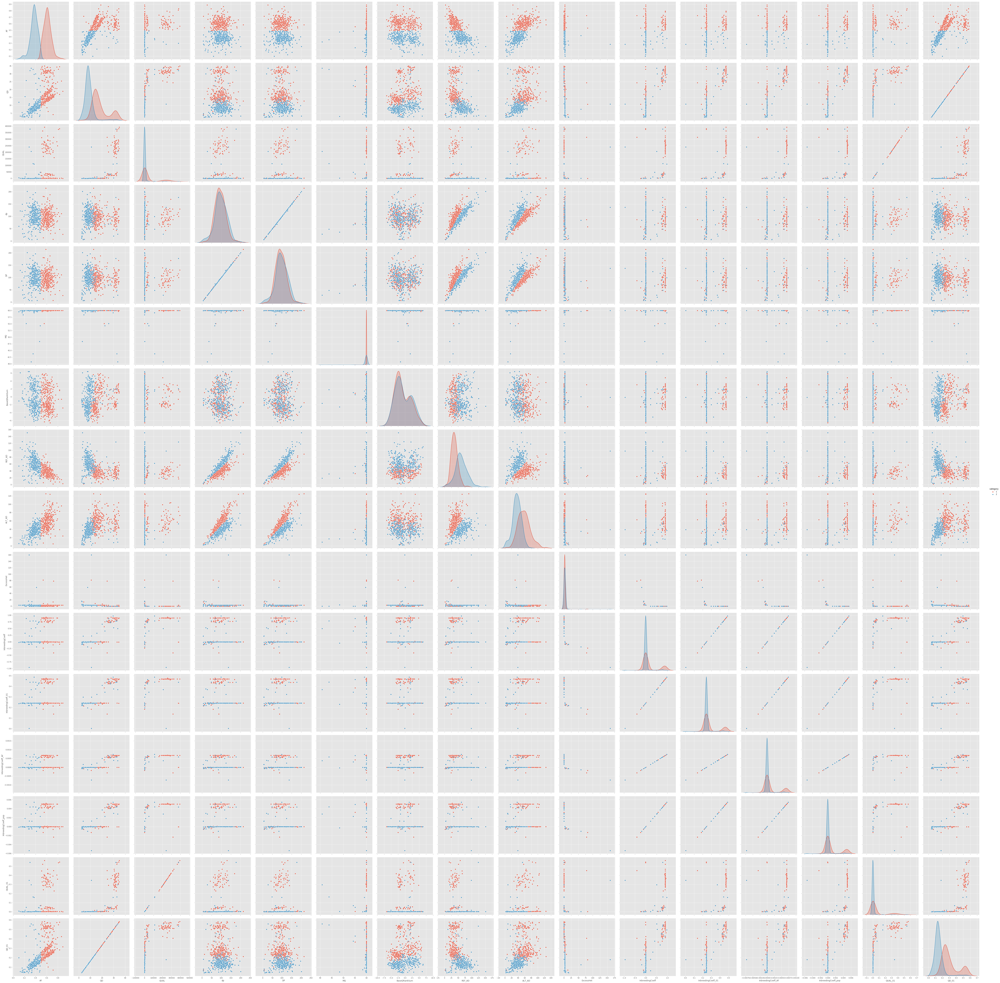

In [38]:
sns.pairplot(Ktest1, hue='category',size=5,vars=["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
                                                 "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
                                                'InbreedingCoeff_01', 'InbreedingCoeff_AF', 
                                                 'InbreedingCoeff_pop', 'QUAL_01', 'QD_01'],kind='scatter')

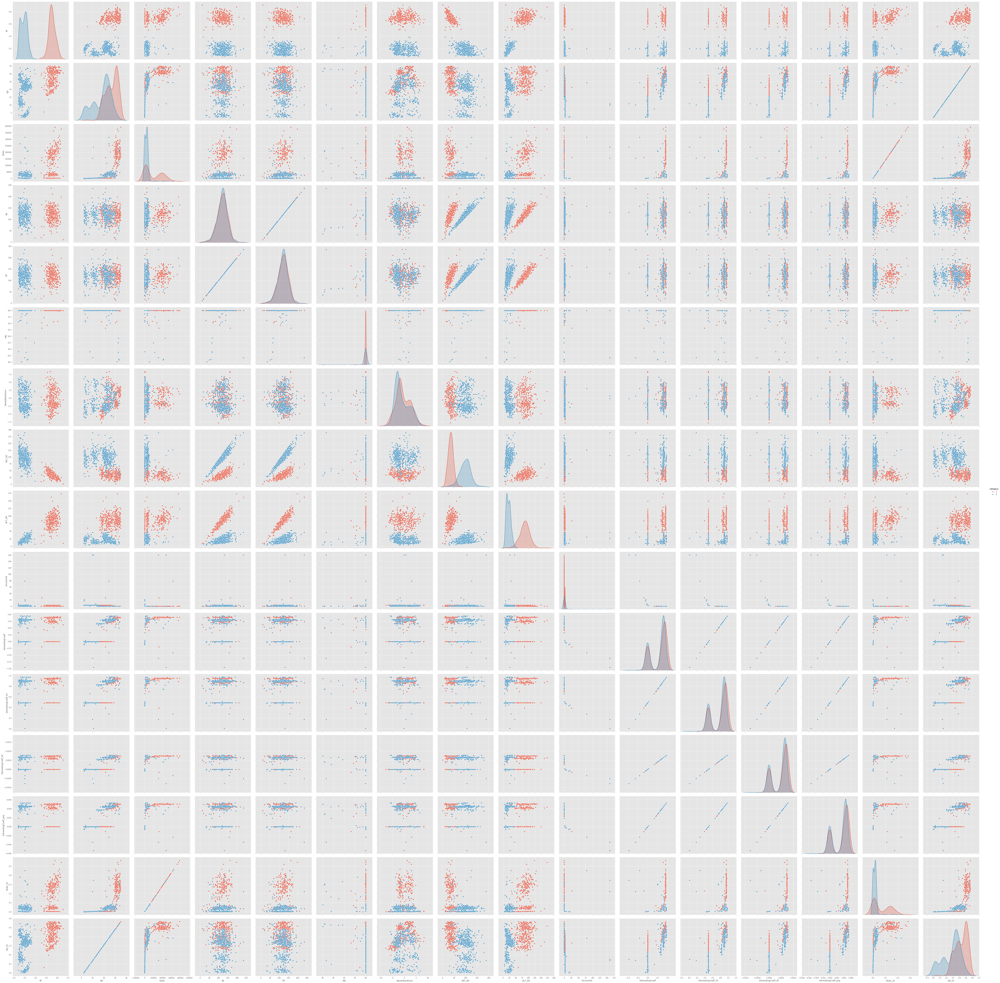

In [39]:
sns.pairplot(Ktest2, hue='category',size=5,vars=["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
                                                 "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
                                                'InbreedingCoeff_01', 'InbreedingCoeff_AF',
                                                 'InbreedingCoeff_pop', 'QUAL_01', 'QD_01'],kind='scatter')

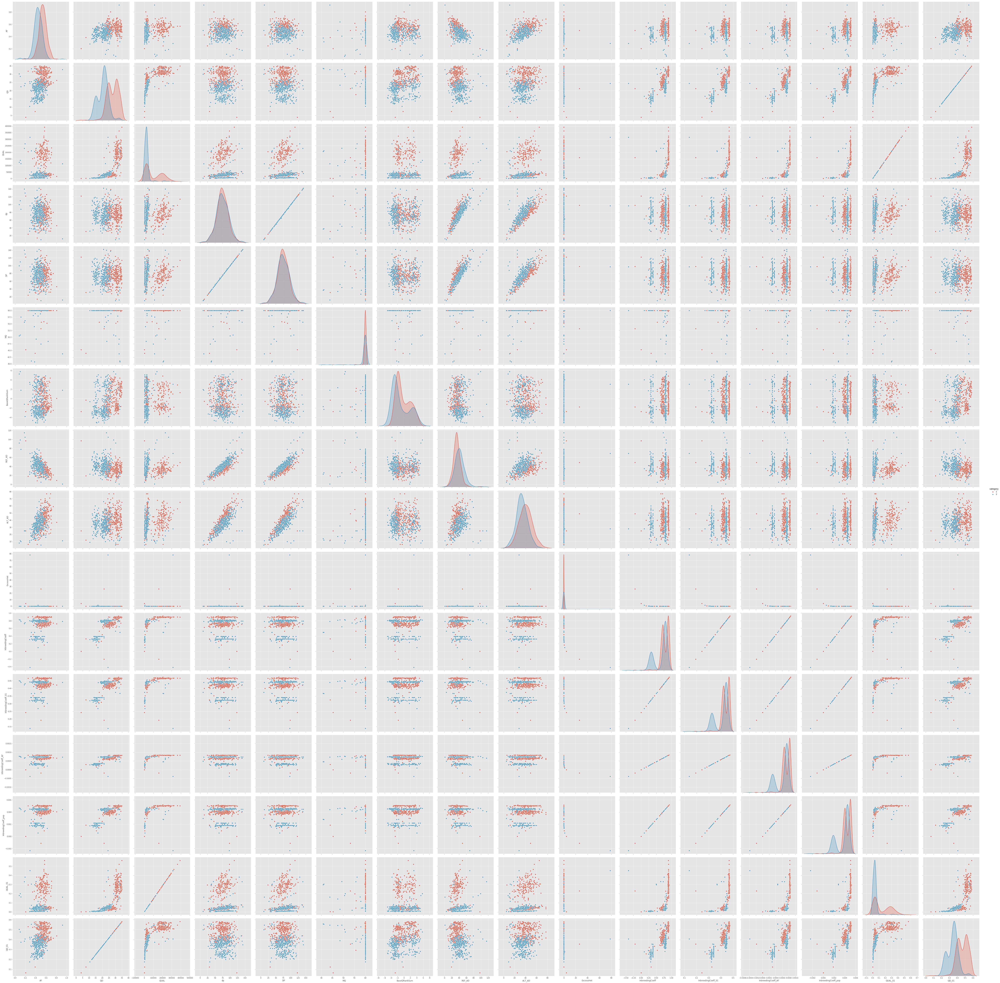

In [40]:
sns.pairplot(Ktest15, hue='category',size=5,vars=["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
                                                 "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
                                                'InbreedingCoeff_01', 'InbreedingCoeff_AF',
                                                 'InbreedingCoeff_pop', 'QUAL_01', 'QD_01'],kind='scatter')

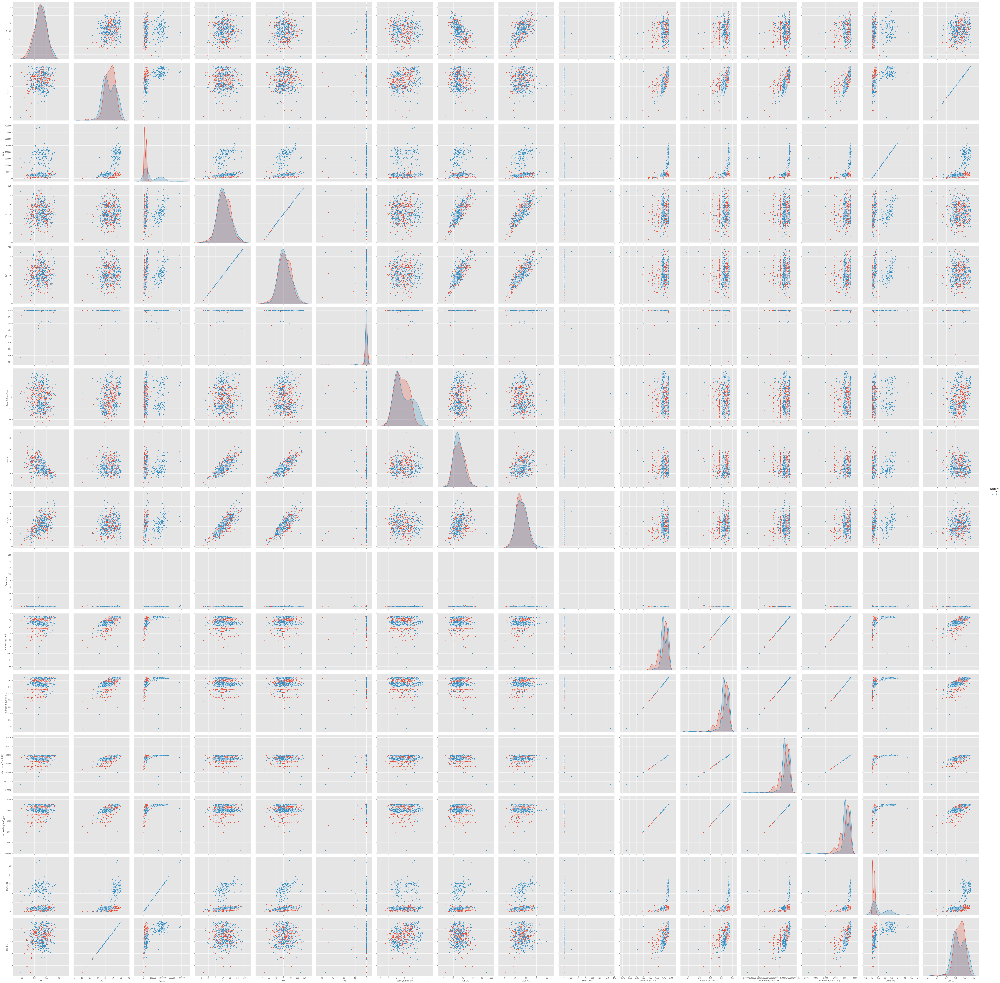

In [41]:
sns.pairplot(Ptest5, hue='category',size=5,vars=["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
                                                 "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
                                                'InbreedingCoeff_01', 'InbreedingCoeff_AF',
                                                 'InbreedingCoeff_pop', 'QUAL_01', 'QD_01'],kind='scatter')

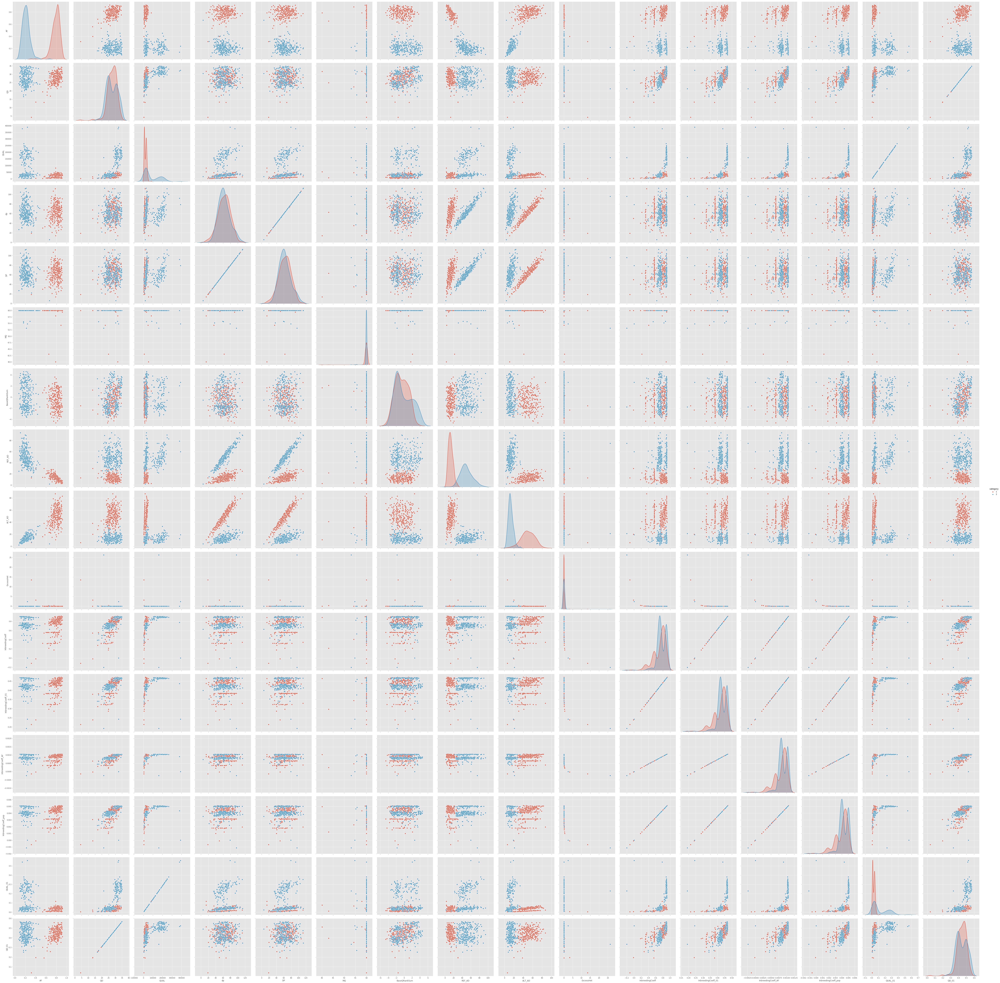

In [42]:
sns.pairplot(Ptest8, hue='category',size=5,vars=["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
                                                 "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
                                                'InbreedingCoeff_01', 'InbreedingCoeff_AF',
                                                 'InbreedingCoeff_pop', 'QUAL_01', 'QD_01'],kind='scatter')

# Feature Importance
---
---

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


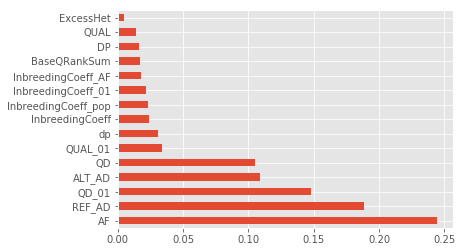

In [43]:
X = Ktest1[["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
          "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
           'InbreedingCoeff_01', 'InbreedingCoeff_AF',
           'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest1['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


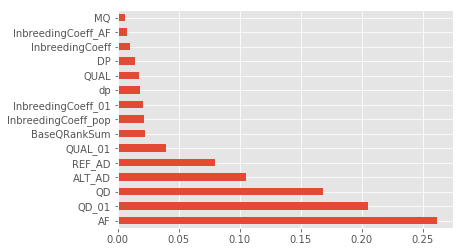

In [44]:
X = Ktest1[["AF","QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
          "REF_AD", "ALT_AD", "ExcessHet", "InbreedingCoeff", 
           'InbreedingCoeff_01', 'InbreedingCoeff_AF',
           'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest1['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


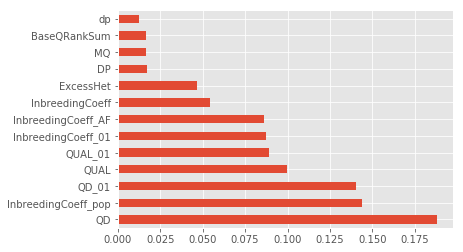

In [45]:
X = Ktest2[["QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
           "ExcessHet", "InbreedingCoeff", 
           'InbreedingCoeff_01', 'InbreedingCoeff_AF',
           'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest2['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


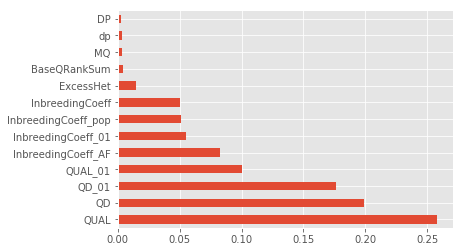

In [46]:
X = Ktest3[["QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
            "ExcessHet", "InbreedingCoeff", 
            'InbreedingCoeff_01', 'InbreedingCoeff_AF',
            'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest3['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


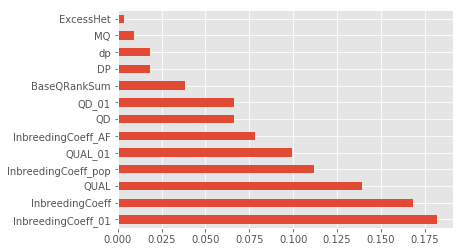

In [47]:
X = Ktest6[["QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
            "ExcessHet", "InbreedingCoeff", 
            'InbreedingCoeff_01', 'InbreedingCoeff_AF',
            'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest6['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


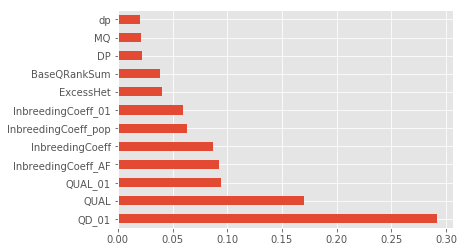

In [48]:
X = Ktest7[[ "QUAL","dp", "DP", "MQ","BaseQRankSum",
            "ExcessHet", "InbreedingCoeff", 
            'InbreedingCoeff_01', 'InbreedingCoeff_AF',
            'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest7['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


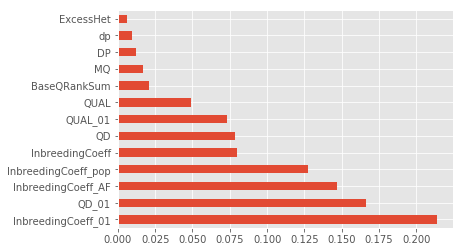

In [49]:
X = Ktest15[["QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
            "ExcessHet", "InbreedingCoeff", 
            'InbreedingCoeff_01', 'InbreedingCoeff_AF',
            'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ktest15['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


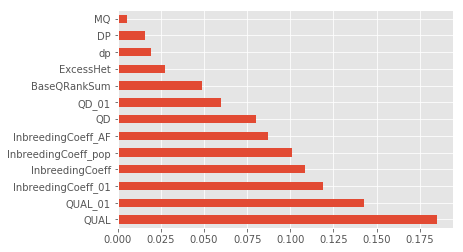

In [50]:
X = Ptest5[["QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
            "ExcessHet", "InbreedingCoeff", 
            'InbreedingCoeff_01', 'InbreedingCoeff_AF',
            'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Ptest5['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

/home/laura/env36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


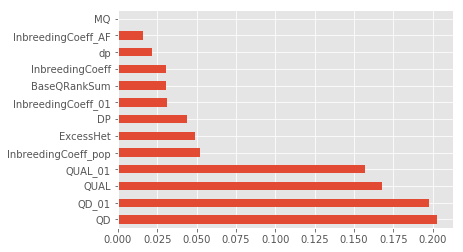

In [51]:
X = Atest5[["QD", "QUAL","dp", "DP", "MQ","BaseQRankSum",
            "ExcessHet", "InbreedingCoeff", 
            'InbreedingCoeff_01', 'InbreedingCoeff_AF',
            'InbreedingCoeff_pop', 'QUAL_01', 'QD_01']]  #independent columns
y = Atest5['category']    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

# Ensemble Learning Model 

https://towardsdatascience.com/ensemble-learning-using-scikit-learn-85c4531ff86a

In [52]:
## Split up the dataset into inputs and targets
X = Ktest15[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y = Ktest15['category']    #target column i.e price range

In [53]:
Ktest15.shape

(718, 48)

In [54]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y)

- ### Random Forest

In [55]:
#create a new random forest classifier
rf = RandomForestClassifier()
#create a dictionary of all values we want to test for n_estimators
params_rf = {'n_estimators': [100, 200, 400]}
#use gridsearch to test all values for n_estimators
rf_gs = GridSearchCV(rf, params_rf, cv=5)
#fit model to training data
rf_gs.fit(X_train, y_train)

GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators='warn', n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'n_estimators': [100, 200, 400]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [56]:
#save best model
rf_best = rf_gs.best_estimator_
#check best n_estimators value
print(rf_gs.best_params_)

{'n_estimators': 100}


Variable: QD                   Importance: 0.22
Variable: InbreedingCoeff      Importance: 0.17
Variable: InbreedingCoeff_01   Importance: 0.16
Variable: InbreedingCoeff_AF   Importance: 0.16
Variable: InbreedingCoeff_pop  Importance: 0.16
Variable: QUAL                 Importance: 0.05
Variable: BaseQRankSum         Importance: 0.03
Variable: ExcessHet            Importance: 0.02
Variable: SOR                  Importance: 0.01
Variable: DP                   Importance: 0.01
Variable: FS                   Importance: 0.01


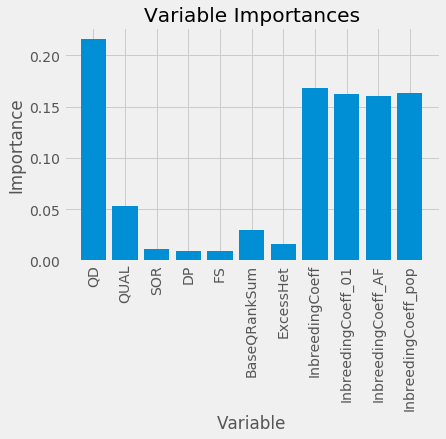

In [57]:
feature_list = X_train.columns.tolist()

# Get numerical feature importances
importances = list(rf_gs.best_estimator_.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

# Set the style
plt.style.use('fivethirtyeight')
# list of x locations for plotting
x_values = list(range(len(importances)))
# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical')
# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')
# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

plt.savefig(os.path.join('img', 'Feature_importance_SOMOZA15.svg'), format="svg")


In [58]:
rf_gs.score(X_test, y_test)

0.9583333333333334

In [59]:
X16 = Ktest16[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y16 = Ktest16['category']    #target column i.e price range

rf_gs.score(X16,y16)

0.9832402234636871

In [60]:
X17 = Ktest17[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y17 = Ktest17['category']    #target column i.e price range

rf_gs.score(X17,y17)

0.9860529986052998

In [61]:
X1 = Ktest1[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y1 = Ktest1['category']    #target column i.e price range

rf_gs.score(X1,y1)

0.5766961651917404

In [62]:
X2 = Ktest2[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y2 = Ktest2['category']    #target column i.e price range

rf_gs.score(X2,y2)

0.7946943483275664

In [63]:
X3 = Ktest3[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y3 = Ktest3['category']    #target column i.e price range

rf_gs.score(X3,y3)

0.40795107033639144

In [64]:
X6 = Ktest6[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y6 = Ktest6['category']    #target column i.e price range

rf_gs.score(X6,y6)

0.5840071877807727

In [65]:
X7 = Ktest7[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y7 = Ktest7['category']    #target column i.e price range

rf_gs.score(X7,y7)

0.7050561797752809

In [66]:
A5 = Atest5[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
a5 = Atest5['category']    #target column i.e price range

rf_gs.score(A5,a5)

0.7142857142857143

In [67]:
A8 = Atest8[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
a8 = Atest8['category']    #target column i.e price range

rf_gs.score(A8,a8)

0.6666666666666666

In [68]:
A9 = Atest9[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
a9 = Atest9['category']    #target column i.e price range

rf_gs.score(A9,a9)

0.6956521739130435

In [69]:
X5 = Ptest5[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y5 = Ptest5['category']    #target column i.e price range

rf_gs.score(X5,y5)

0.38102893890675243

In [70]:
X8 = Ptest8[["QD", "QUAL", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y8 = Ptest8['category']    #target column i.e price range

rf_gs.score(X8,y8)

0.38461538461538464

- ### Random Forest using P1 in silico

In [71]:
## Split up the dataset into inputs and targets
X = Ptest8[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y = Ptest8['category']    #target column i.e price range

In [72]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y)

In [73]:
#create a new random forest classifier
rf = RandomForestClassifier()
#create a dictionary of all values we want to test for n_estimators
params_rf = {'n_estimators': [100, 200, 400]}
#use gridsearch to test all values for n_estimators
rf_gs = GridSearchCV(rf, params_rf, cv=5)
#fit model to training data
rf_gs.fit(X_train, y_train)

GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators='warn', n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'n_estimators': [100, 200, 400]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [74]:
#save best model
rf_best = rf_gs.best_estimator_
#check best n_estimators value
print(rf_gs.best_params_)

{'n_estimators': 100}


In [75]:
rf = RandomForestClassifier(n_estimators = 1000, random_state = 42)
# Train the model on training data
rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=None,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

Variable: QUAL_01              Importance: 0.27
Variable: InbreedingCoeff_01   Importance: 0.14
Variable: InbreedingCoeff_pop  Importance: 0.13
Variable: InbreedingCoeff      Importance: 0.12
Variable: InbreedingCoeff_AF   Importance: 0.11
Variable: QD_01                Importance: 0.06
Variable: FS                   Importance: 0.06
Variable: ExcessHet            Importance: 0.04
Variable: BaseQRankSum         Importance: 0.03
Variable: SOR                  Importance: 0.02
Variable: DP                   Importance: 0.02


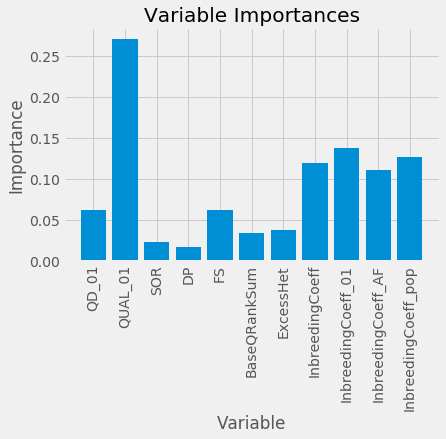

In [76]:
feature_list = X_train.columns.tolist()

# Get numerical feature importances
importances = list(rf_gs.best_estimator_.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

# Set the style
plt.style.use('fivethirtyeight')
# list of x locations for plotting
x_values = list(range(len(importances)))
# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical')
# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')
# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

plt.savefig(os.path.join('img', 'Feature_importance_SOMOZA15.svg'), format="svg")


In [77]:
rf_gs.score(X_test, y_test)

0.943089430894309

AUC: 0.989


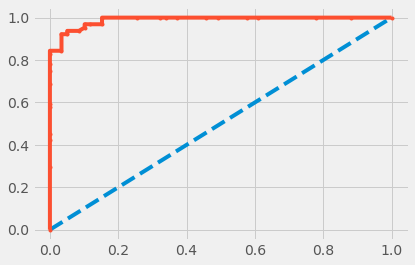

In [106]:
y_test_bin = np.where(y_test == 1, 0, 1)
# predict probabilities
probs = rf_gs.best_estimator_.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
auc = roc_auc_score(y_test_bin, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
fpr, tpr, thresholds = roc_curve(y_test_bin, probs)
# plot no skill
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot

plt.savefig(os.path.join('img', 'ROC_P1_test.svg'), format="svg")


plt.show()

In [79]:
X5 = Ptest5[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y5 = Ptest5['category']    #target column i.e price range

rf_gs.score(X5,y5)

0.9726688102893891

In [80]:
X9 = Ptest9[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y9 = Ptest9['category']    #target column i.e price range

rf_gs.score(X9,y9)

0.9893048128342246

In [81]:
X95 = Ptest95[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y95 = Ptest95['category']    #target column i.e price range

rf_gs.score(X95,y95)

0.99

In [82]:
A5 = Atest5[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
a5 = Atest5['category']    #target column i.e price range

rf_gs.score(A5,a5)

0.6285714285714286

In [83]:
A8 = Atest8[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
a8 = Atest8['category']    #target column i.e price range

rf_gs.score(A8,a8)

0.6666666666666666

In [84]:
A9 = Atest9[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
a9 = Atest9['category']    #target column i.e price range

rf_gs.score(A9,a9)

0.6956521739130435

In [85]:
X16 = Ktest16[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y16 = Ktest16['category']    #target column i.e price range
y16 = np.where(y16 == 1, 2, 1)

rf_gs.score(X16,y16)

0.9203910614525139

In [86]:
X17 = Ktest17[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y17 = Ktest17['category']    #target column i.e price range
y17 = np.where(y17 == 1, 2, 1)

rf_gs.score(X17,y17)

0.9163179916317992

In [87]:
X15 = Ktest15[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y15 = Ktest15['category']    #target column i.e price range
y15 = np.where(y15 == 1, 2, 1)

rf_gs.score(X15,y15)

0.9220055710306406

In [88]:
X1 = Ktest1[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y1 = Ktest1['category']    #target column i.e price range
y1 = np.where(y1 == 1, 2, 1)

rf_gs.score(X1,y1)

0.5575221238938053

In [89]:
X2 = Ktest2[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y2 = Ktest2['category']    #target column i.e price range
y2 = np.where(y2 == 1, 2, 1)

rf_gs.score(X2,y2)

0.8166089965397924

In [90]:
X3 = Ktest3[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y3 = Ktest3['category']    #target column i.e price range
#y3 = np.where(y3 == 1, 3, 1)

rf_gs.score(X3,y3)

0.6990825688073394

In [91]:
X6 = Ktest6[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y6 = Ktest6['category']    #target column i.e price range
y6 = np.where(y6 == 1, 2, 1)

rf_gs.score(X6,y6)

0.633423180592992

In [92]:
X7 = Ktest7[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]  #independent columns
y7 = Ktest7['category']    #target column i.e price range
y7 = np.where(y7 == 1, 2, 1)

rf_gs.score(X7,y7)

0.5561797752808989

In [93]:
label8 = rf_gs.predict(X)

In [94]:
Ptest8['label'] = label8

In [95]:
Ptest8.head()

,#CHROM,POS,ID,REF,ALT,QUAL,FILTER,INFO,FORMAT,sample,AC,af,AN,BaseQRankSum,DP,ExcessHet,FS,InbreedingCoeff,MQ,MQRankSum,QD,ReadPosRankSum,SOR,GT,AD,GQ,PL,PGT,PID,PS,len_AD,REF_AD,ALT_AD,gt0,gt1,dp,aF,AF,Is_repeat,snp_left_distance,snp_right_distance,Window_10,InbreedingCoeff_01,InbreedingCoeff_AF,InbreedingCoeff_pop,QUAL_01,QD_01,category,label
0,MTB_anc,1977,.,G,A,24220.49,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.434;DP=42;Ex...,GT:AD:DP:GQ:PL,"0/1:10,32:42:99:1029,0,201",1.0,0.5,2.0,0.434,42.0,0.0,1.001,0.7816,60.0,0.0,30.16,0.251,0.567,0/1,"10,32",99.0,"1029,0,201",NaN,NaN,NaN,2,10.0,32.0,0,1,42.0,0.238095,0.761905,False,1977.0,555.0,1,0.438243,0.000909,0.004391,0.034733,0.485517,1,1
2,MTB_anc,6140,.,G,T,26113.26,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=0.136;DP=52;Ex...,GT:AD:DP:GQ:PL,"0/1:43,9:52:99:216,0,1203",1.0,0.5,2.0,0.136,52.0,0.0,4.397,0.7016,60.0,0.0,25.96,0.468,0.667,0/1,"43,9",99.0,"216,0,1203",NaN,NaN,NaN,2,43.0,9.0,0,1,52.0,0.826923,0.173077,False,3608.0,1445.0,1,0.418191,0.000816,0.003942,0.037453,0.413103,2,2
3,MTB_anc,7585,.,C,G,40201.36,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.10;DP=72;Exc...,GT:AD:DP:GQ:PL,"0/1:22,50:72:99:1564,0,485",1.0,0.5,2.0,1.100,72.0,0.0,0.000,0.7999,60.0,0.0,29.09,-0.405,0.627,0/1,"22,50",99.0,"1564,0,485",NaN,NaN,NaN,2,22.0,50.0,0,1,72.0,0.305556,0.694444,False,1445.0,1558.0,1,0.442829,0.000930,0.004494,0.057695,0.467069,1,1
5,MTB_anc,9304,.,A,G,42092.24,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.44;DP=84;Exc...,GT:AD:DP:GQ:PL,"0/1:14,70:84:99:2294,0,216",1.0,0.5,2.0,1.440,84.0,0.0,0.707,0.8302,60.0,0.0,29.13,-0.480,0.590,0/1,"14,70",99.0,"2294,0,216",NaN,NaN,NaN,2,14.0,70.0,0,1,84.0,0.166667,0.833333,False,161.0,1437.0,1,0.450424,0.000965,0.004664,0.060412,0.467759,1,1
6,MTB_anc,10741,.,C,G,27327.44,PASS,AC=1;AF=0.500;AN=2;BaseQRankSum=1.53;DP=68;Exc...,GT:AD:DP:GQ:PL,"0/1:20,48:68:99:1445,0,553",1.0,0.5,2.0,1.530,68.0,0.0,6.458,0.7883,60.0,0.0,31.09,-0.615,1.365,0/1,"20,48",99.0,"1445,0,553",NaN,NaN,NaN,2,20.0,48.0,0,1,68.0,0.294118,0.705882,False,1437.0,2719.0,1,0.439922,0.000917,0.004429,0.039198,0.501552,1,1


In [96]:
label5 = rf_gs.predict(X5)
Ptest5['label'] = label5

In [97]:
label9 = rf_gs.predict(X9)
Ptest9['label'] = label9

# Check label asigned using AF

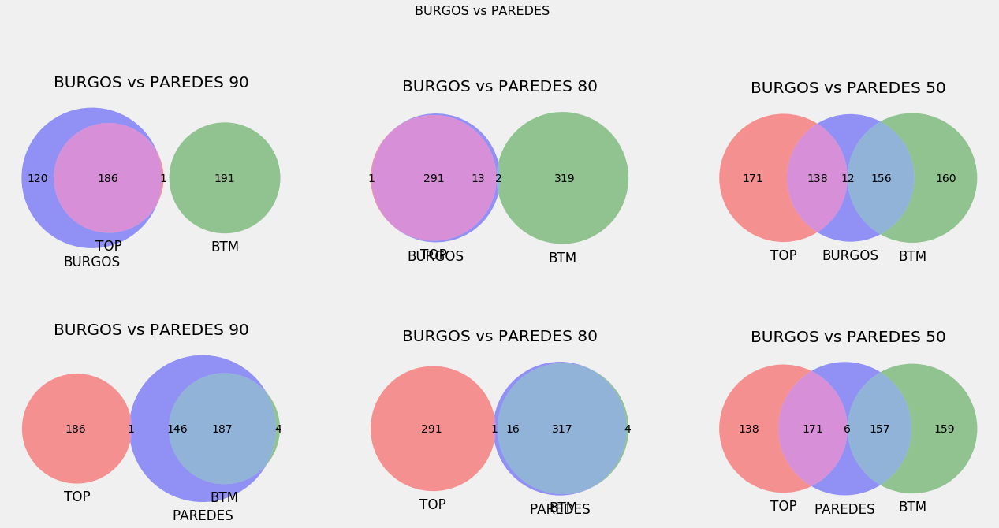

In [98]:
plt.figure(figsize=(20,10))

plt.subplot(2, 3, 1)
plt.title("BURGOS vs PAREDES 90")
v3 = venn3([set(dict_t_b['P1_90'][0]), set(dict_t_b['P1_90'][1]), B_exclusive], 
            set_labels = ('TOP', 'BTM', 'BURGOS'))

plt.subplot(2, 3, 2)
plt.title("BURGOS vs PAREDES 80")
v3 = venn3([set(dict_t_b['P1_80'][0]), set(dict_t_b['P1_80'][1]), B_exclusive], 
            set_labels = ('TOP', 'BTM', 'BURGOS'))

plt.subplot(2, 3, 3)
plt.title("BURGOS vs PAREDES 50")
v3 = venn3([set(dict_t_b['P1_50'][0]), set(dict_t_b['P1_50'][1]), B_exclusive], 
            set_labels = ('TOP', 'BTM', 'BURGOS'))

plt.suptitle('BURGOS vs PAREDES', fontsize=16, verticalalignment='bottom')


plt.subplot(2, 3, 4)
plt.title("BURGOS vs PAREDES 90")
v3 = venn3([set(dict_t_b['P1_90'][0]), set(dict_t_b['P1_90'][1]), P_exclusive], 
            set_labels = ('TOP', 'BTM', 'PAREDES'))

plt.subplot(2, 3, 5)
plt.title("BURGOS vs PAREDES 80")
v3 = venn3([set(dict_t_b['P1_80'][0]), set(dict_t_b['P1_80'][1]), P_exclusive], 
            set_labels = ('TOP', 'BTM', 'PAREDES'))

plt.subplot(2, 3, 6)
plt.title("BURGOS vs PAREDES 50")
v3 = venn3([set(dict_t_b['P1_50'][0]), set(dict_t_b['P1_50'][1]), P_exclusive], 
            set_labels = ('TOP', 'BTM', 'PAREDES'))

#v3.get_patch_by_id('100').set_color('r')
#v3.get_patch_by_id('010').set_color('c')
#v3.get_patch_by_id('001').set_color('g')

#v3.get_patch_by_id('101').set_alpha(alpha)
#v3.get_patch_by_id('011').set_alpha(alpha)

#plt.savefig(os.path.join('img', 'P1.svg'), format="svg")

plt.show()

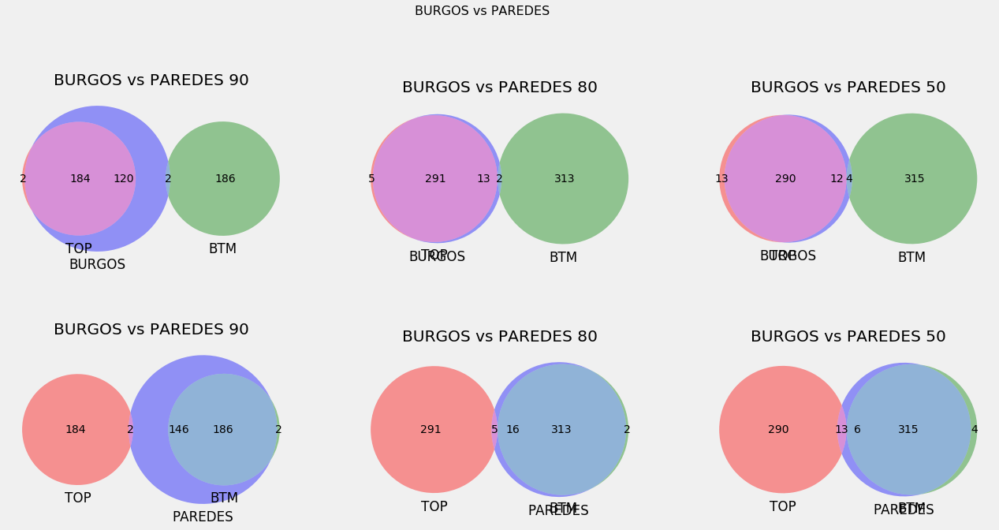

In [99]:
plt.figure(figsize=(20,10))

plt.subplot(2, 3, 1)
plt.title("BURGOS vs PAREDES 90")
v3 = venn3([set(Ptest9['POS'][Ptest9.label == 1]), set(Ptest9['POS'][Ptest9.label == 2]), B_exclusive], 
            set_labels = ('TOP', 'BTM', 'BURGOS'))

plt.subplot(2, 3, 2)
plt.title("BURGOS vs PAREDES 80")
v3 = venn3([set(Ptest8['POS'][Ptest8.label == 1]), set(Ptest8['POS'][Ptest8.label == 2]), B_exclusive], 
            set_labels = ('TOP', 'BTM', 'BURGOS'))

plt.subplot(2, 3, 3)
plt.title("BURGOS vs PAREDES 50")
v3 = venn3([set(Ptest5['POS'][Ptest5.label == 1]), set(Ptest5['POS'][Ptest5.label == 2]), B_exclusive], 
            set_labels = ('TOP', 'BTM', 'BURGOS'))

plt.suptitle('BURGOS vs PAREDES', fontsize=16, verticalalignment='bottom')


plt.subplot(2, 3, 4)
plt.title("BURGOS vs PAREDES 90")
v3 = venn3([set(Ptest9['POS'][Ptest9.label == 1]), set(Ptest9['POS'][Ptest9.label == 2]), P_exclusive], 
            set_labels = ('TOP', 'BTM', 'PAREDES'))

plt.subplot(2, 3, 5)
plt.title("BURGOS vs PAREDES 80")
v3 = venn3([set(Ptest8['POS'][Ptest8.label == 1]), set(Ptest8['POS'][Ptest8.label == 2]), P_exclusive], 
            set_labels = ('TOP', 'BTM', 'PAREDES'))

plt.subplot(2, 3, 6)
plt.title("BURGOS vs PAREDES 50")
v3 = venn3([set(Ptest5['POS'][Ptest5.label == 1]), set(Ptest5['POS'][Ptest5.label == 2]), P_exclusive], 
            set_labels = ('TOP', 'BTM', 'PAREDES'))

#v3.get_patch_by_id('100').set_color('r')
#v3.get_patch_by_id('010').set_color('c')
#v3.get_patch_by_id('001').set_color('g')

#v3.get_patch_by_id('101').set_alpha(alpha)
#v3.get_patch_by_id('011').set_alpha(alpha)

plt.savefig(os.path.join('img', 'P1_Essemble_ML_model_P180_feature_reduced.svg'), format="svg")

plt.show()

# SOMOZA

In [110]:
label15 = rf_gs.predict(X15)
Ktest15['label'] = label15

In [101]:
label16 = rf_gs.predict(X16)
Ktest16['label'] = label16

In [102]:
label17 = rf_gs.predict(X17)
Ktest17['label'] = label17

<Figure size 1440x720 with 0 Axes>

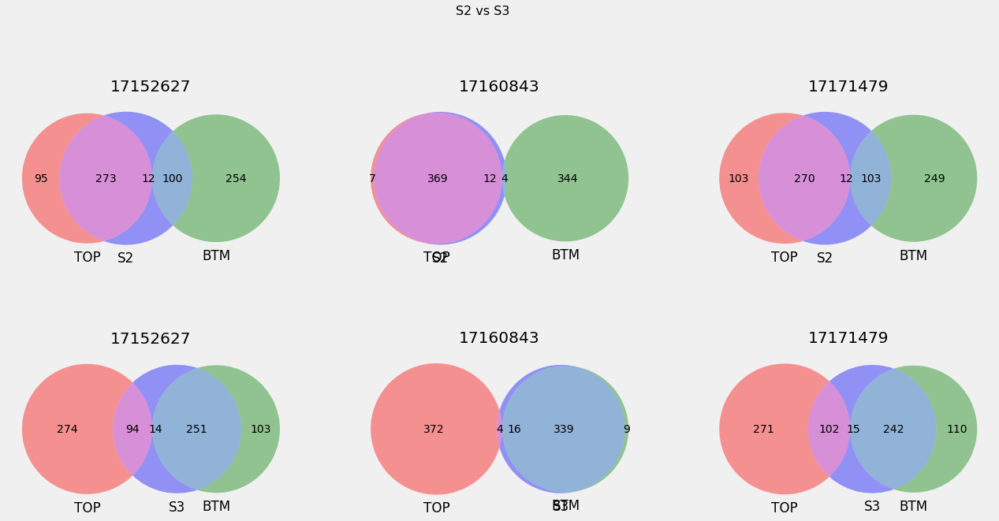

In [103]:
plt.figure(figsize=(20,10))

plt.figure(figsize=(20,10))

plt.subplot(2, 3, 1)
plt.title("17152627")
v3 = venn3([set(dict_t_b['17152627'][0]), set(dict_t_b['17152627'][1]), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.subplot(2, 3, 2)
plt.title("17160843")
v3 = venn3([set(dict_t_b['17160843'][0]), set(dict_t_b['17160843'][1]), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.subplot(2, 3, 3)
plt.title("17171479")
v3 = venn3([set(dict_t_b['17171479'][0]), set(dict_t_b['17171479'][1]), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.suptitle('S2 vs S3', fontsize=16, verticalalignment='bottom')



plt.subplot(2, 3, 4)
plt.title("17152627")
v3 = venn3([set(dict_t_b['17152627'][0]), set(dict_t_b['17152627'][1]), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.subplot(2, 3, 5)
plt.title("17160843")
v3 = venn3([set(dict_t_b['17160843'][0]), set(dict_t_b['17160843'][1]), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.subplot(2, 3, 6)
plt.title("17171479")
v3 = venn3([set(dict_t_b['17171479'][0]), set(dict_t_b['17171479'][1]), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.savefig(os.path.join('img', 'SOMOZA_ALL_venn.svg'), format="svg")

plt.show()

<Figure size 1440x720 with 0 Axes>

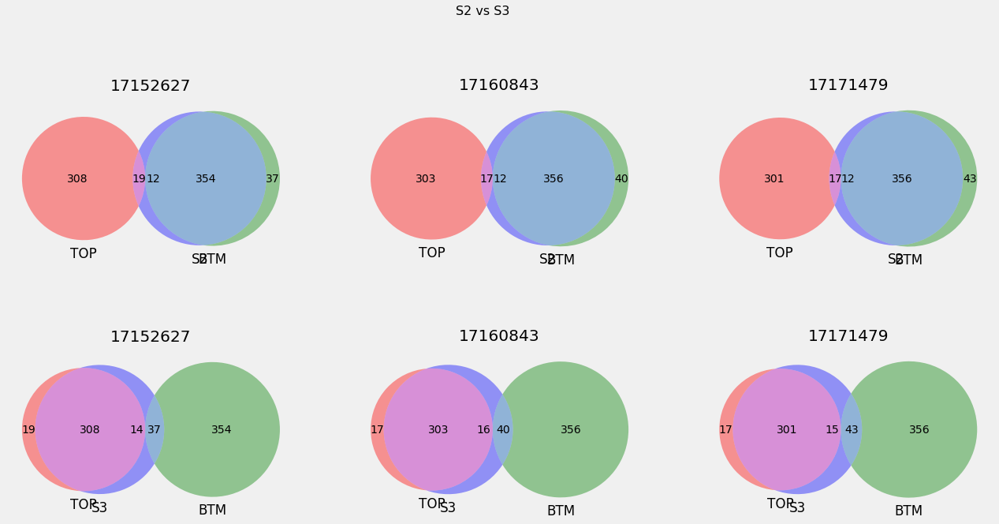

In [104]:
plt.figure(figsize=(20,10))

plt.figure(figsize=(20,10))

plt.subplot(2, 3, 1)
plt.title("17152627")
v3 = venn3([set(Ktest15['POS'][Ktest15.label == 1]), set(set(Ktest15['POS'][Ktest15.label == 2])), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.subplot(2, 3, 2)
plt.title("17160843")
v3 = venn3([set(Ktest16['POS'][Ktest16.label == 1]), set(set(Ktest16['POS'][Ktest16.label == 2])), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.subplot(2, 3, 3)
plt.title("17171479")
v3 = venn3([set(Ktest17['POS'][Ktest17.label == 1]), set(set(Ktest17['POS'][Ktest17.label == 2])), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.suptitle('S2 vs S3', fontsize=16, verticalalignment='bottom')



plt.subplot(2, 3, 4)
plt.title("17152627")
v3 = venn3([set(Ktest15['POS'][Ktest15.label == 1]), set(set(Ktest15['POS'][Ktest15.label == 2])), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.subplot(2, 3, 5)
plt.title("17160843")
v3 = venn3([set(Ktest16['POS'][Ktest16.label == 1]), set(set(Ktest16['POS'][Ktest16.label == 2])), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.subplot(2, 3, 6)
plt.title("17171479")
v3 = venn3([set(Ktest17['POS'][Ktest17.label == 1]), set(set(Ktest17['POS'][Ktest17.label == 2])), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.savefig(os.path.join('img', 'SOMOZA_ALL_ML_model_P180_feature_reduced.svg'), format="svg")

plt.show()

<Figure size 1440x720 with 0 Axes>

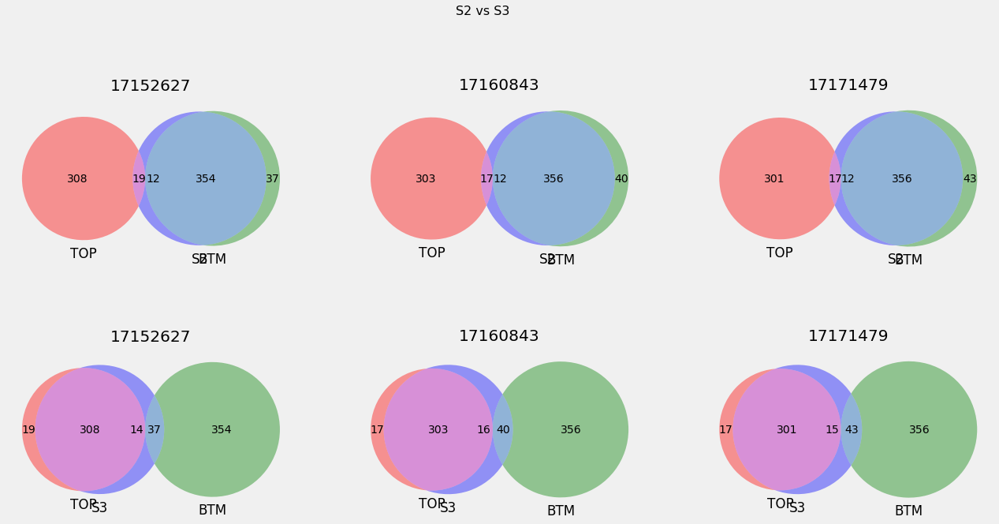

In [105]:
plt.figure(figsize=(20,10))

plt.figure(figsize=(20,10))

plt.subplot(2, 3, 1)
plt.title("17152627")
v3 = venn3([set(Ktest15['POS'][Ktest15.label == 1]), set(set(Ktest15['POS'][Ktest15.label == 2])), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.subplot(2, 3, 2)
plt.title("17160843")
v3 = venn3([set(Ktest16['POS'][Ktest16.label == 1]), set(set(Ktest16['POS'][Ktest16.label == 2])), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.subplot(2, 3, 3)
plt.title("17171479")
v3 = venn3([set(Ktest17['POS'][Ktest17.label == 1]), set(set(Ktest17['POS'][Ktest17.label == 2])), S2_exclusive], 
            set_labels = ('TOP', 'BTM', 'S2'))

plt.suptitle('S2 vs S3', fontsize=16, verticalalignment='bottom')



plt.subplot(2, 3, 4)
plt.title("17152627")
v3 = venn3([set(Ktest15['POS'][Ktest15.label == 1]), set(set(Ktest15['POS'][Ktest15.label == 2])), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.subplot(2, 3, 5)
plt.title("17160843")
v3 = venn3([set(Ktest16['POS'][Ktest16.label == 1]), set(set(Ktest16['POS'][Ktest16.label == 2])), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

plt.subplot(2, 3, 6)
plt.title("17171479")
v3 = venn3([set(Ktest17['POS'][Ktest17.label == 1]), set(set(Ktest17['POS'][Ktest17.label == 2])), S3_exclusive], 
            set_labels = ('TOP', 'BTM', 'S3'))

#plt.savefig(os.path.join('img', 'SOMOZA_ALL_ML_model_P180_feature_reduced.svg'), format="svg")

plt.show()

# Split group 1 and 2  for annotation

In [129]:
dict_allpos_dict = {}
for name_dff, df_dff in dict_dff.items():
    dict_allpos_dict[name_dff] = df_dff.set_index('POS')['ALT'].to_dict()

In [130]:
for name_dsf, dict_dsf_df in dict_allpos_dict.items():
    print(name_dsf)
    #print(dict_dsf_df)
    get_lineage_snp(dict_dsf_df)

16250874FFD
This strain has those lineage positions:
: 4.3
: 4.3.4.2
: 4.3.4

17152627
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.3
: 4.1.2
: 4.3.4.2
: 4.3.4

17160843
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.3
: 4.1.2
: 4.3.4.2
: 4.3.4

17171479
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.3
: 4.1.2
: 4.3.4.2
: 4.3.4

1mixed
This strain has those lineage positions:
: 4.2.2
: 4.2

2mixed
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.3
: 4.1.2
: 4.3.4.2
: 4.3.4

3mixed
This strain has those lineage positions:
: 4.4.1.1
: 1
: 1.2.2
: 4.4.1
: 4.4

4mixed
This strain has those lineage positions:
: 2
: 2.2.1
: 2.2

56850173
This strain has those lineage positions:
: 4.3
: 4.3.4.2
: 4.3.4

5mixed
This strain has those lineage positions:
: 2
: 2.2.1
: 2.2

6mixed
This strain has those lineage positions:
: 4.3.3
: 2
: 4.3
: 2.2.1
: 2.2

7mixed
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.1.2
: 4.8

AL-75607
Th

In [131]:
for name_dsf, dict_dsf_df in dict_allpos_dict.items():
    print(name_dsf)
    get_resistance_snp(dict_dsf_df)

16250874FFD
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

17152627
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

17160843
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

17171479
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

1mixed
No resistance were found

2mixed
No resistance were found

3mixed
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:781687:G:*:streptomycin (SM)
:1417019:T:ethambutol_(EMB)
:2155168:G:*:isoniazid (INH)
:4245969:T:ethambutol_(EMB)
:4247431:A:*:ethambutol (EMB)

4mixed
This strain has resistance positions:
:781687:G:*:streptomycin (SM)
:781822:G:*:streptomycin (SM)
:1673425:T:*:isoniazid (INH)
:2155168:G:*:isoniazid (INH)
:424

In [119]:
def split_df_group_todict(vcf_df, model):
    
    df_htz = vcf_df[(vcf_df.AC != 2) & (vcf_df.gt0 != 1)] #remove homozygous positions
    
    X = df_htz[["QD_01", "QUAL_01", "SOR", "DP",  
            "FS","BaseQRankSum", "ExcessHet",
            "InbreedingCoeff", 'InbreedingCoeff_01',
             'InbreedingCoeff_AF', 'InbreedingCoeff_pop']]
    #print("prediction")
    label = model.predict(X)
    #print(label)
    df_htz['label'] = label
    #print("labeled")
    positions_one_df = df_htz[df_htz.label == 1]
    positions_two_df = df_htz[df_htz.label == 2]
    
    one_positions_dict = positions_one_df.set_index('POS')['ALT'].to_dict()
    two_positions_dict = positions_two_df.set_index('POS')['ALT'].to_dict()

    return one_positions_dict, two_positions_dict

In [120]:
dict_one_two = {}
for name_dff, df_dff in dict_dff.items():
    name = name_dff
    print(name_dff)
    name_one = name + "_one"
    name_two = name + "_two"
    
    dict_one_two[name_one] = split_df_group_todict(df_dff, rf_gs)[0]
    dict_one_two[name_two] = split_df_group_todict(df_dff, rf_gs)[1]

16250874FFD


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


17152627


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


17160843


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


17171479


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


1mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


2mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


3mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


4mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


56850173


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


5mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


6mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


7mixed


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


AL-75607


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


AL14621


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


BURGOS89109


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P1_50


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P1_80


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P1_90


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P1_95


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P2_50


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P2_80


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P2_90


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P2_95


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P3_50


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P3_80


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P3_90


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


P3_95


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


SOMOZACOL2


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


SOMOZACOL3


/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/home/laura/env36/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


In [123]:
for name_dict, dict_value in dict_one_two.items():
    print(name_dict)
    get_lineage_snp(dict_value)

16250874FFD_one
No lineage were found

16250874FFD_two
No lineage were found

17152627_one
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.1.2

17152627_two
This strain has those lineage positions:
: 4.3
: 4.3.4.2
: 4.3.4

17160843_one
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.1.2

17160843_two
This strain has those lineage positions:
: 4.3
: 4.3.4.2
: 4.3.4

17171479_one
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.1.2

17171479_two
This strain has those lineage positions:
: 4.3
: 4.3.4.2
: 4.3.4

1mixed_one
This strain has those lineage positions:
: 4.2.2
: 4.2

1mixed_two
No lineage were found

2mixed_one
This strain has those lineage positions:
: 4.1
: 4.1.2.1
: 4.1.2
: 4.3.4

2mixed_two
This strain has those lineage positions:
: 4.3
: 4.3.4.2

3mixed_one
This strain has those lineage positions:
: 4.4.1.1
: 1
: 1.2.2
: 4.4.1
: 4.4

3mixed_two
No lineage were found

4mixed_one
No lineage were found

4mixed_two
No lineage were found

56

In [125]:
for name_dict, dict_value in dict_one_two.items():
    print(name_dict)
    get_resistance_snp(dict_value)

16250874FFD_one
No resistance were found

16250874FFD_two
No resistance were found

17152627_one
No resistance were found

17152627_two
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

17160843_one
No resistance were found

17160843_two
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

17171479_one
No resistance were found

17171479_two
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:2155168:G:*:isoniazid (INH)
:4247431:A:*:ethambutol (EMB)

1mixed_one
No resistance were found

1mixed_two
No resistance were found

2mixed_one
No resistance were found

2mixed_two
No resistance were found

3mixed_one
This strain has resistance positions:
:1417019:T:ethambutol_(EMB)
:4245969:T:ethambutol_(EMB)

3mixed_two
This strain has resistance positions:
:761155:T:*:rifampicin (RMP)
:781687:G:*:streptomycin (SM)
:2155168:G:*:ison

In [128]:
for name_dict, dict_value in dict_one_two.items():
    print(name_dict, len(dict_value))

16250874FFD_one 6
16250874FFD_two 4
17152627_one 329
17152627_two 393
17160843_one 324
17160843_two 400
17171479_one 324
17171479_two 401
1mixed_one 583
1mixed_two 95
2mixed_one 594
2mixed_two 273
3mixed_one 1358
3mixed_two 277
4mixed_one 168
4mixed_two 45
56850173_one 4
56850173_two 4
5mixed_one 169
5mixed_two 33
6mixed_one 251
6mixed_two 862
7mixed_one 608
7mixed_two 104
AL-75607_one 7
AL-75607_two 2
AL14621_one 6
AL14621_two 2
BURGOS89109_one 4
BURGOS89109_two 1
P1_50_one 305
P1_50_two 320
P1_80_one 297
P1_80_two 316
P1_90_one 189
P1_90_two 189
P1_95_one 59
P1_95_two 44
P2_50_one 33
P2_50_two 9
P2_80_one 32
P2_80_two 8
P2_90_one 25
P2_90_two 6
P2_95_one 14
P2_95_two 2
P3_50_one 13
P3_50_two 2
P3_80_one 13
P3_80_two 4
P3_90_one 10
P3_90_two 4
P3_95_one 5
P3_95_two 4
SOMOZACOL2_one 2
SOMOZACOL2_two 2
SOMOZACOL3_one 4
SOMOZACOL3_two 8


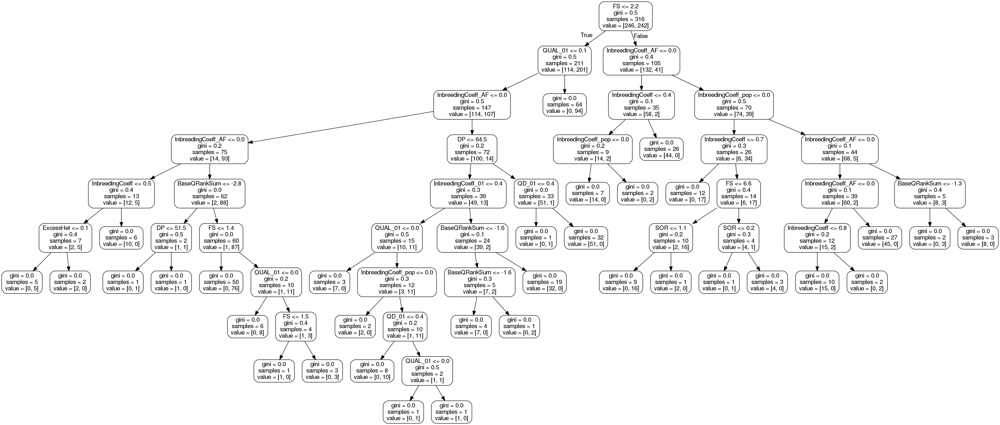

In [138]:
feature_list = X_train.columns.tolist()

# Pull out one tree from the forest
tree = rf_gs.best_estimator_.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = feature_list, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')
Image('tree.png')